<a href="https://colab.research.google.com/github/Emna-chebbi/crops-images-classification/blob/main/agriculture.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Data loading and preparing

In [101]:
# Import the necessary libraries
import numpy as np
from numpy import asarray
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns

import os.path
from os import path

from google.colab import files

import matplotlib.pyplot as plt
import cv2 as cv
import cv2

from PIL import Image
from skimage.io import imread

We loaded Kaggle Dataset directly into Google Colab by using an API token that can be easily generated from the profile section of your Kaggle account, a file named “kaggle.json” containing the username and the API key will be downloaded and then we uploaded it to google colab

In [102]:
#Install the Kaggle library
! pip install kaggle

In [103]:
#Make a directory named “.kaggle”
! mkdir ~/.kaggle

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [104]:
#Copy the “kaggle.json” into this new directory
! cp kaggle.json ~/.kaggle/

cp: cannot stat 'kaggle.json': No such file or directory


In [105]:
#Allocate the required permission for this file
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [106]:
#Downloading Datasets
! kaggle datasets download aman2000jaiswal/agriculture-crop-images

Dataset URL: https://www.kaggle.com/datasets/aman2000jaiswal/agriculture-crop-images
License(s): other
agriculture-crop-images.zip: Skipping, found more recently modified local copy (use --force to force download)


In [107]:
def load_dataset():

  if path.isdir('/kaggle/input'):
    if path.exists("/kaggle/input/Crop_details.csv"):
      print("already existed and loaded...")
    else:
      # unzip the dataset
      print("unzip the dataset....")
      ! unzip /content/agriculture-crop-images.zip -d /kaggle/input
  else: # if the /kaggle/input is not created then create the folders.
      ! mkdir /kaggle
      ! mkdir /kaggle/input
      ! unzip /content/agriculture-crop-images.zip -d /kaggle/input

  return None

In [108]:
load_dataset()

already existed and loaded...


In [109]:
load_dataset() # cross check once you loaded the dataset

already existed and loaded...


In [110]:
# cross check the folders and files
path.isdir('/kaggle')
path.exists("/kaggle/input/Crop_details.csv")
path.exists("/kaggle/input/crop_images/jute/jute002a.jpeg")

True

In [111]:
# load the cropdetails file that contains the 3 columns image path and crop name and crop label. we don't need Unnamed column so drop that.
df = pd.read_csv("/kaggle/input/Crop_details.csv",index_col=None).drop("Unnamed: 0",axis=1)
df.head()

,path,crop,croplabel
0,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg,sugarcane,3
1,/kaggle/input/kag2/sugarcane/sugarcane034a.jpeg,sugarcane,3
2,/kaggle/input/kag2/sugarcane/sugarcane032arot....,sugarcane,3
3,/kaggle/input/kag2/sugarcane/sugarcane036ahs.jpeg,sugarcane,3
4,/kaggle/input/kag2/sugarcane/sugarcane023ahs.jpeg,sugarcane,3


#observation:
1. path column represents the path of the stored image in the notebook
2. crop column represents the label of the stored image.
3. croplabel represents the label of the given crop
4. maize-1 , rice-2 , sugarcane-3 , wheat-4 , jute-5.

In [112]:
#overview of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 999 entries, 0 to 998
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   path       999 non-null    object
 1   crop       999 non-null    object
 2   croplabel  999 non-null    int64 
dtypes: int64(1), object(2)
memory usage: 23.5+ KB


In [113]:
#generates descriptive statistics for the numeric columns of a DataFrame
df.describe()

,croplabel
count,999.000000
mean,2.008008
std,1.417729
min,0.000000
25%,1.000000
50%,2.000000
75%,3.000000
max,4.000000


In [114]:
#returns the dimensions of a DataFrame (rows, columns)
df.shape

(999, 3)

In [115]:
#checking for missing values (null values) in a DataFrame
df.isnull().sum()

,0
path,0
crop,0
croplabel,0


In [116]:
#check for duplicate rows in a DataFrame and return the total count of such rows.
df.duplicated().sum()

0

In [117]:
#creates a copy of the DataFrame
data = df.copy()

Dataset Analysis

In [118]:
def dataset_analysis(dataframe):
  """
  this function takes the dataframe as input  and it gives the no of images of the each label.
  and display the some sample images of the each crop type.
  """

  crops_list = ["wheat","sugarcane","jute","maize","rice"]


  for i in crops_list:
    data_crop = dataframe[dataframe["crop"]==i] # extract the required crop data from the given dataframe.
    print("{1} of images of the {0} crop in our dataset.".format(i,len(data_crop))) # how many images I have for each crop.
    figr = plt.figure(figsize=(30,30)) # width,height of the figure.
    rows=1
    columns=10
    for imageno,imagepath in enumerate(data_crop["path"][10:20]): # takes the 10 rows of the given crop data.
      image = cv.imread(imagepath)
      figr.add_subplot(rows,columns,imageno+1)
      plt.imshow(image)
      plt.axis("off") # it turn off the axis dimensions
      plt.title("{}".format(i)) # corresponding crop name as the title.
  return None

203 of images of the wheat crop in our dataset.
199 of images of the sugarcane crop in our dataset.
199 of images of the jute crop in our dataset.
199 of images of the maize crop in our dataset.
199 of images of the rice crop in our dataset.


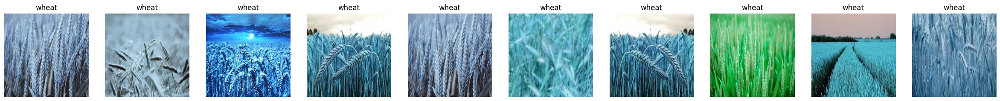

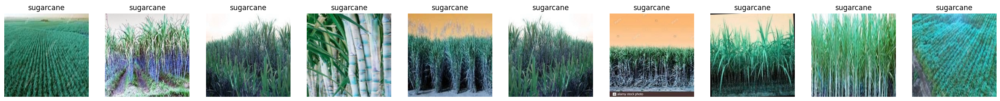

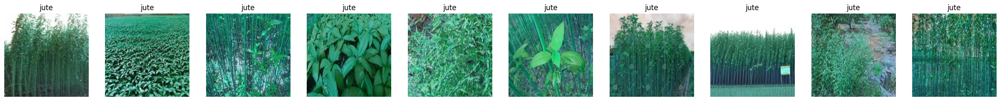

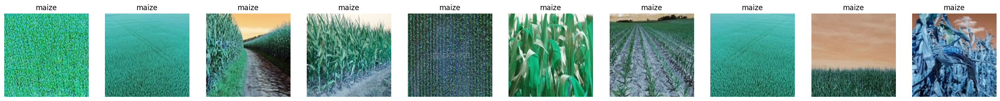

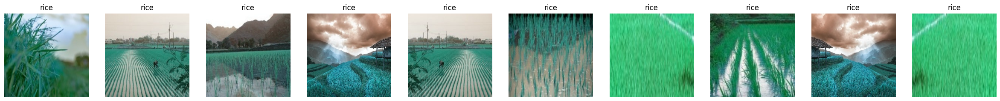

In [119]:
dataset_analysis(df)

observation:
It gives the different types of the images of the corresponding crop by displaying 10 images of the each crop.
our given dataset is balanced.

Target Analysis

In [120]:
def target_column_analysis(df,col):
  """ this function to analyze the  column on given dataframe"""
  plt.figure(figsize=(15,5))
  plt.subplot(1,2,1)
  df[col][:].value_counts().plot.pie(autopct="%1.2f%%",shadow=True)

  plt.title("%contribution of {0} ".format(col),fontweight = 'bold',fontsize=14, color = 'brown')

  plt.subplot(1,2,2)

  sns.countplot(x=df[col][:])
  plt.title("#of values in {0}".format(col),fontweight = 'bold',fontsize=14, color = 'brown')
  plt.show()

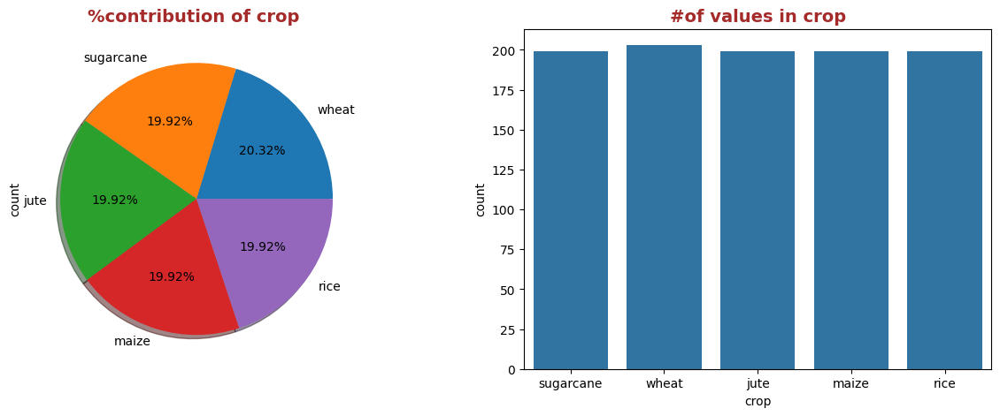

In [121]:
target_column_analysis(df,"crop")

observation:
1. In the given dataset "crop" is the target column to classify.
2. 203 of images of the wheat crop in our dataset.
3. 199 of images of the sugarcane crop in our dataset.
4. 199 of images of the jute crop in our dataset.
5. 199 of images of the maize crop in our dataset.
6. 199 of images of the rice crop in our dataset.

Crop Image Analysis

In [122]:
#jute data
df_jute = df[df['croplabel']==0][["path","crop"]]
df_jute.head(3)

#maize data
df_maize = df[df["croplabel"]==1][["path","crop"]]
df_maize.head(3)

#rice data
df_rice = df[df["croplabel"]==2][["path","crop"]]
df_rice.head(3)

#sugarcane data
df_sugarcane = df[df["croplabel"]==3][["path","crop"]]
df_sugarcane.head(3)

#wheat data
df_wheat = df[df["croplabel"]==4][["path","crop"]]
df_wheat.head(3)

,path,crop
159,/kaggle/input/kag2/wheat/wheat0004a.jpeg,wheat
160,/kaggle/input/kag2/wheat/wheat017a.jpeg,wheat
161,/kaggle/input/kag2/wheat/wheat004a.jpeg,wheat


Required Manual Functions

In [123]:
def image_analysis(image_path,crop_name):
  im = Image.open(image_path)
  print(" summarize the basic details of the image...")
  print("="*50)
  print("The format of the image : ",im.format)
  print("The size of the image : ",im.size)
  print("The mode of the image : ",im.mode)

  print(crop_name.upper().center(200,"-"))
  pic = cv.imread(image_path)
  plt.figure(figsize=(5,10))
  plt.imshow(pic)
  plt.show()

  # basic properties of the image
  print('Type of the image : ',type(pic))
  print('Shape of the given image : {}'.format(pic.shape))
  print('Image Hight {}'.format(pic.shape[0]))
  print('Image Width {}'.format(pic.shape[1]))
  print('Dimension of Image {}'.format(pic.ndim))
  # The shape of the ndarray is a three layered matrix.
  #length and width, and the third number is for the three layers: Red, Green, Blue.
  #the size of a RGB image is the total size will be counted as height x width x 3

  print('Image size(ht*width*#of channels) : {}'.format(pic.size))
  print('Maximum RGB value in this image : {} '.format(pic.max()))
  print('Minimum RGB value in this image : {} '.format(pic.min()))

  return None


In [124]:
def image_pixel_analysis(image_path,crop_name,row_val,col_val):
  """
    This function takes the image path , crop name and some pixel of height
    and width gives how the channels are designed and hw they distributed .

    0 index value for Red channel
    1 index value for Green channel
    2 index value for Blue channel
  """

  print(crop_name.upper().center(200,"-"))
  pic = cv.imread(image_path)

  print("pixel values at {0} row and {1} column.".format(row_val,col_val))
  print('Value of only R channel {}'.format(pic[row_val, col_val, 0])) # channel-0
  print('Value of only G channel {}'.format(pic[row_val,col_val, 1])) # channel-1
  print('Value of only B channel {}'.format(pic[row_val,col_val, 2])) # channel-2

  figr = plt.figure(figsize=(30,10))
  rows = 1
  columns = 4
  #subplot1
  figr.add_subplot(rows,columns,1)
  plt.title("RGB image",fontweight = 'bold',fontsize=14, color = 'Brown')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic)

  # subplot2
  figr.add_subplot(rows,columns,2)
  plt.title('Red channel',fontweight = 'bold',fontsize=14, color = 'red')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic[ : , : , 0]) # height range , width range , channel no

  # subplot3
  figr.add_subplot(rows,columns,3)
  plt.title('Green channel',fontweight = 'bold',fontsize=14, color = 'green')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic[ : , : , 1])

  # subplot4
  figr.add_subplot(rows,columns,4)
  plt.title('Blue channel',fontweight = 'bold',fontsize=14, color = 'blue')
  plt.ylabel('{} pxl Height'.format(pic.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic.shape[1]))
  plt.imshow(pic[ : , : , 2])
  plt.show()


  figr2 = plt.figure(figsize=(30,5))

  #subplot 1
  # tuple to select colors of each channel line
  figr2.add_subplot(rows,columns,1)
  colors = ("red", "green", "blue")
  channel_ids = (0, 1, 2)

  # create the histogram plot
  figr2.add_subplot(rows,columns,1)
  for channel_id, colr in zip(channel_ids, colors):
    histogram, bin_edges = np.histogram(pic[:, :, channel_id], bins=256, range=(0, 256))
    plt.plot(bin_edges[0:-1], histogram, color=colr)

  plt.title("Color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")


  # subplot2
  figr2.add_subplot(rows,columns,2)
  hist1,bin1 = np.histogram(pic[:,:,0],bins=256,range=(0,255+1))
  plt.plot(bin1[0:-1],hist1,color="red")
  plt.title("red Color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")


  # subplot3
  figr2.add_subplot(rows,columns,3)
  hist2,bin2 = np.histogram(pic[:,:,1],bins=256,range=(0,255+1))
  plt.plot(bin2[0:-1],hist2,color="Green")
  plt.title("Green color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")

  # subplot2
  figr2.add_subplot(rows,columns,4)
  hist3,bin3 = np.histogram(pic[:,:,2],bins=256,range=(0,255+1))
  plt.plot(bin3[0:-1],hist3,color="Blue")
  plt.title(" Blue Color Histogram")
  plt.xlabel("Color value")
  plt.xlim([0, 256])
  plt.ylabel("Pixel count")
  plt.show()


In [125]:
def transformations_image(image_path,crop_name):
  print(crop_name.upper().center(200,"-")) # Required. The length of the returned string , The character to fill the missing space on each side. Default is " " (space)
  """
     this function is takes the image path ass the input and gives the how the image appeared with different transformations.
  """
  figr = plt.figure(figsize=(25,10)) # imgwidth,imgheight
  rows =1
  columns = 5
  pic1 = cv.imread(image_path) # read the image into array format
  print("shape of the given image : ",pic1.shape)
  # subplot1
  figr.add_subplot(rows,columns,1)
  plt.title("general image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.imshow(pic1)
  plt.ylabel('{} pxl Height'.format(pic1.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic1.shape[1]))

  # subplot2
  figr.add_subplot(rows,columns,2)
  plt.title("Normalized image",fontweight = 'bold',fontsize=14, color = 'orange')
  pic11 = (pic1/255)
  plt.imshow(pic11)
  plt.ylabel('{} pxl Height'.format(pic11.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic11.shape[1]))

  # subplot2
  pic2 =255- pic1
  figr.add_subplot(rows,columns,3)
  plt.title("negative image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.imshow(pic2)
  plt.ylabel('{} pxl Height'.format(pic2.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic2.shape[1]))


  # subplot3
  gamma=2.2

  pic3 =((pic1/255)**(1/gamma))
  figr.add_subplot(rows,columns,4)
  plt.imshow(pic3)
  plt.title("gamma Image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.ylabel('{} pxl Height'.format(pic3.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic3.shape[1]))


  # subplot4
  pic4 = imread(image_path, as_gray=True)
  figr.add_subplot(rows,columns,5)
  plt.imshow(pic4,cmap=cm.gray)

  plt.title("gray image",fontweight = 'bold',fontsize=14, color = 'orange')
  plt.ylabel('{} pxl Height'.format(pic4.shape[0]))
  plt.xlabel('{} pxl Width'.format(pic4.shape[1]))


  plt.show()
  figr.savefig('transformation.jpg')
  return None

Jute images analysis

 summarize the basic details of the image...
The format of the image :  JPEG
The size of the image :  (224, 224)
The mode of the image :  RGB
--------------------------------------------------------------------------------------------------JUTE--------------------------------------------------------------------------------------------------


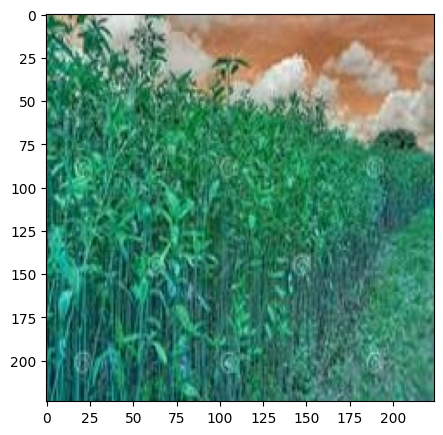

Type of the image :  <class 'numpy.ndarray'>
Shape of the given image : (224, 224, 3)
Image Hight 224
Image Width 224
Dimension of Image 3
Image size(ht*width*#of channels) : 150528
Maximum RGB value in this image : 255 
Minimum RGB value in this image : 0 


In [126]:
idx_ = 100
image_analysis(df_jute.iloc[idx_]["path"],df_jute.iloc[idx_]["crop"])

observation:
1. The displayed JUTE crop image in JPEG format
2. The given image in RGB format
3. shape of the given image is (224,224,3)
4. height of the given image is 224 , width of the given image is 224 , it contain 3 channels(red,green,blue)
5. pixel values are in the range(0-255)

--------------------------------------------------------------------------------------------------JUTE--------------------------------------------------------------------------------------------------
pixel values at 150 row and 100 column.
Value of only R channel 50
Value of only G channel 104
Value of only B channel 91


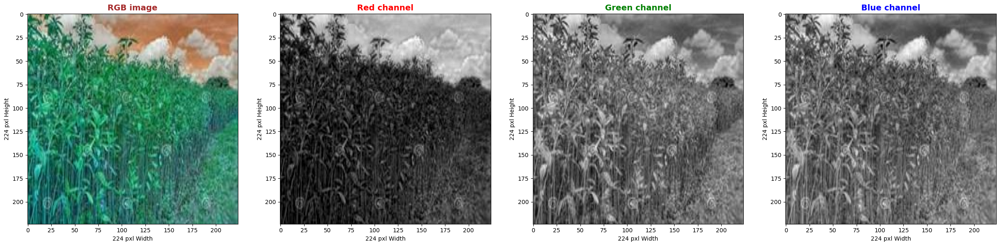

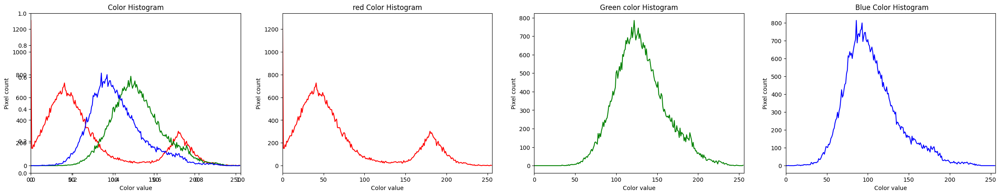

In [127]:
row_px = 150 # value < image width(224)
col_px = 100 # value < image height(224)
image_pixel_analysis(df_jute.iloc[idx_]["path"],df_jute.iloc[idx_]["crop"],row_px,col_px)

- most of the red pixel value is 50
- most of the green pixel value contains 100-200
- most of the blue pixel vlaue contains 50-150

--------------------------------------------------------------------------------------------------JUTE--------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


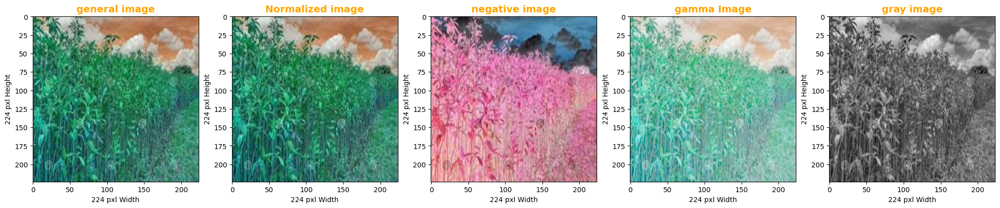

In [128]:
transformations_image(df_jute.iloc[idx_]["path"],df_jute.iloc[idx_]["crop"])

Maize images analysis

 summarize the basic details of the image...
The format of the image :  JPEG
The size of the image :  (224, 224)
The mode of the image :  RGB
-------------------------------------------------------------------------------------------------MAIZE--------------------------------------------------------------------------------------------------


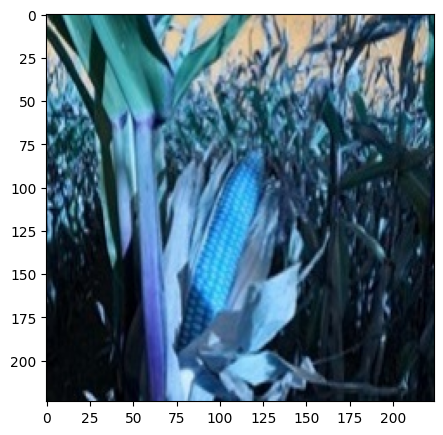

Type of the image :  <class 'numpy.ndarray'>
Shape of the given image : (224, 224, 3)
Image Hight 224
Image Width 224
Dimension of Image 3
Image size(ht*width*#of channels) : 150528
Maximum RGB value in this image : 255 
Minimum RGB value in this image : 0 


In [129]:
idx_ = 4 #45
image_analysis(df_maize.iloc[idx_]["path"],df_maize.iloc[idx_]["crop"])

-------------------------------------------------------------------------------------------------MAIZE--------------------------------------------------------------------------------------------------
pixel values at 150 row and 100 column.
Value of only R channel 66
Value of only G channel 202
Value of only B channel 250


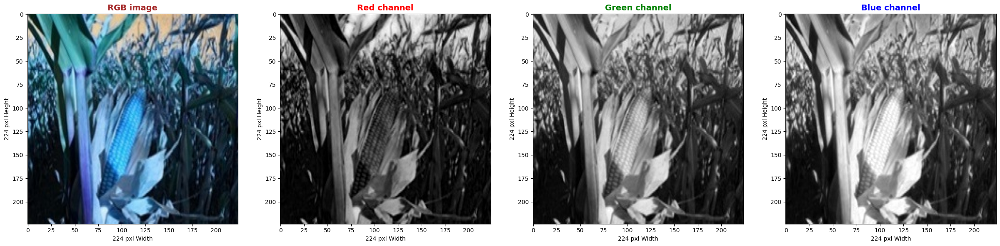

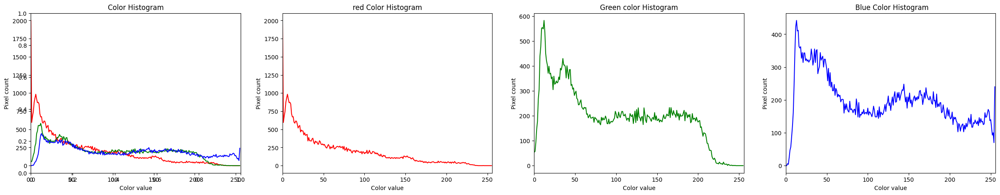

In [130]:
row_px = 150
col_px = 100
image_pixel_analysis(df_maize.iloc[idx_]["path"],df_maize.iloc[idx_]["crop"],row_px,col_px)

-------------------------------------------------------------------------------------------------MAIZE--------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


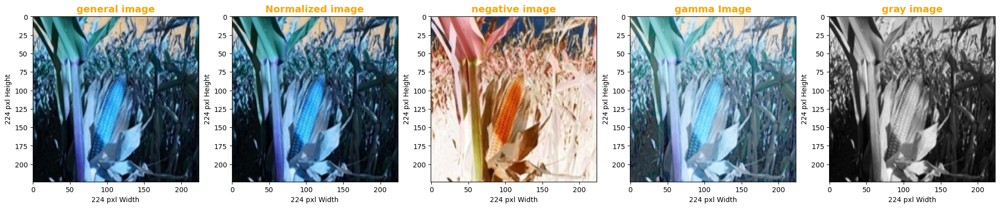

In [131]:
transformations_image(df_maize.iloc[idx_]["path"],df_maize.iloc[idx_]["crop"])

Rice image analysis

 summarize the basic details of the image...
The format of the image :  JPEG
The size of the image :  (224, 224)
The mode of the image :  RGB
--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------


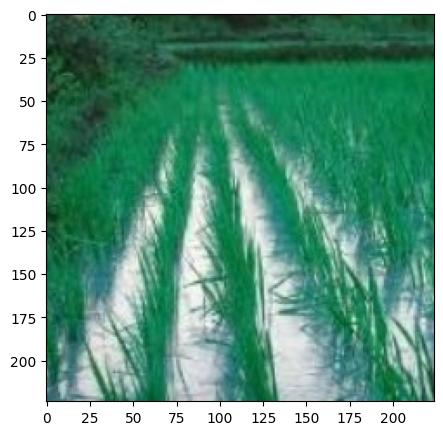

Type of the image :  <class 'numpy.ndarray'>
Shape of the given image : (224, 224, 3)
Image Hight 224
Image Width 224
Dimension of Image 3
Image size(ht*width*#of channels) : 150528
Maximum RGB value in this image : 255 
Minimum RGB value in this image : 0 


In [132]:
idx_ = 17
image_analysis(df_rice.iloc[idx_]["path"],df_rice.iloc[idx_]["crop"])

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
pixel values at 150 row and 100 column.
Value of only R channel 52
Value of only G channel 120
Value of only B channel 95


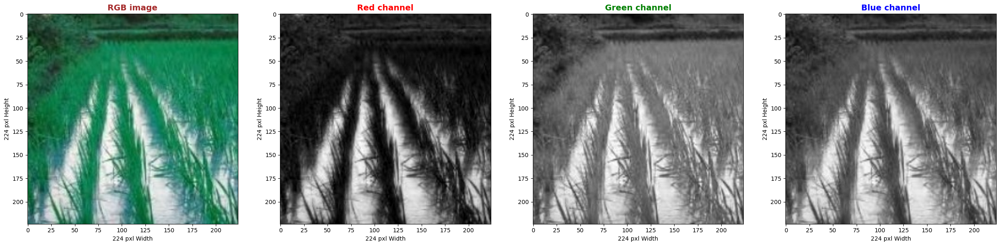

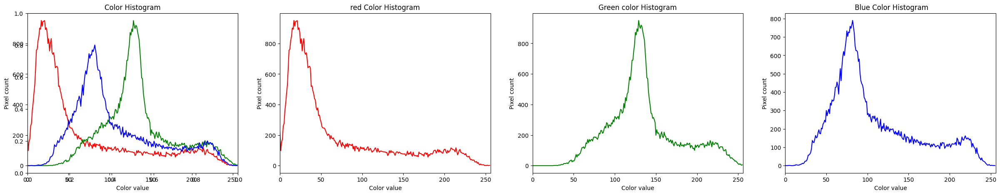

In [133]:
row_px = 150
col_px = 100
image_pixel_analysis(df_rice.iloc[idx_]["path"],df_rice.iloc[idx_]["crop"],row_px,col_px)

--------------------------------------------------------------------------------------------------RICE--------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


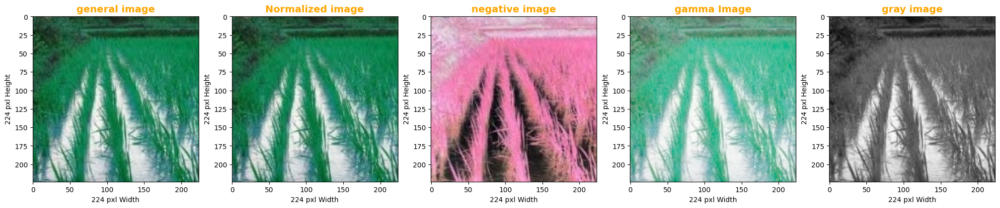

In [134]:
transformations_image(df_rice.iloc[idx_]["path"],df_rice.iloc[idx_]["crop"])

Sugarcane images analysis

 summarize the basic details of the image...
The format of the image :  JPEG
The size of the image :  (224, 224)
The mode of the image :  RGB
-----------------------------------------------------------------------------------------------SUGARCANE------------------------------------------------------------------------------------------------


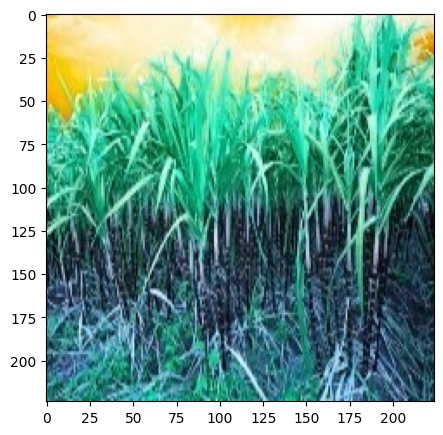

Type of the image :  <class 'numpy.ndarray'>
Shape of the given image : (224, 224, 3)
Image Hight 224
Image Width 224
Dimension of Image 3
Image size(ht*width*#of channels) : 150528
Maximum RGB value in this image : 255 
Minimum RGB value in this image : 0 


In [135]:
idx_ = 100
image_analysis(df_sugarcane.iloc[idx_]["path"],df_sugarcane.iloc[idx_]["crop"])

-----------------------------------------------------------------------------------------------SUGARCANE------------------------------------------------------------------------------------------------
pixel values at 150 row and 100 column.
Value of only R channel 88
Value of only G channel 115
Value of only B channel 136


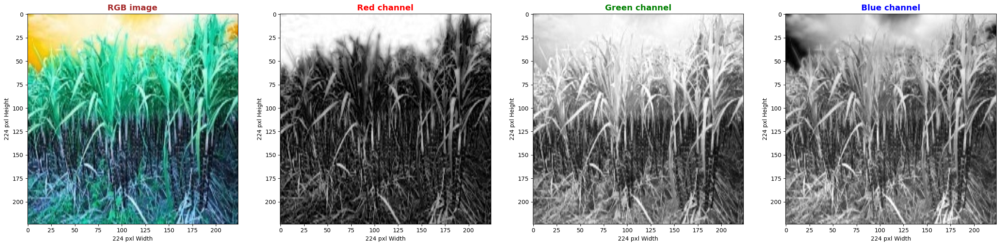

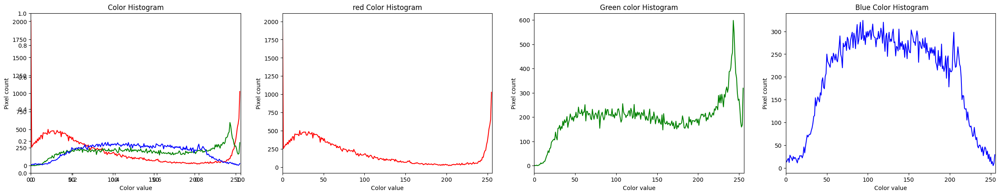

In [136]:
row_px = 150
col_px = 100
image_pixel_analysis(df_sugarcane.iloc[idx_]["path"],df_sugarcane.iloc[idx_]["crop"],row_px,col_px)

-----------------------------------------------------------------------------------------------SUGARCANE------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


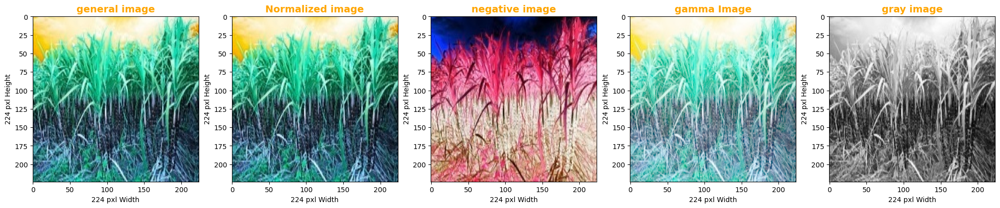

In [137]:
transformations_image(df_sugarcane.iloc[idx_]["path"],df_sugarcane.iloc[idx_]["crop"])

Wheat images analysis

 summarize the basic details of the image...
The format of the image :  JPEG
The size of the image :  (224, 224)
The mode of the image :  RGB
-------------------------------------------------------------------------------------------------WHEAT--------------------------------------------------------------------------------------------------


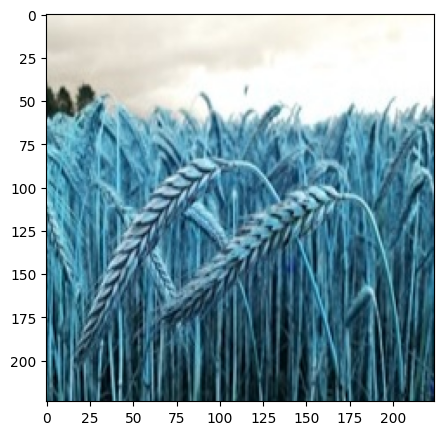

Type of the image :  <class 'numpy.ndarray'>
Shape of the given image : (224, 224, 3)
Image Hight 224
Image Width 224
Dimension of Image 3
Image size(ht*width*#of channels) : 150528
Maximum RGB value in this image : 255 
Minimum RGB value in this image : 0 


In [138]:
idx_ = 13
image_analysis(df_wheat.iloc[idx_]["path"],df_wheat.iloc[idx_]["crop"])

-------------------------------------------------------------------------------------------------WHEAT--------------------------------------------------------------------------------------------------
pixel values at 150 row and 100 column.
Value of only R channel 64
Value of only G channel 118
Value of only B channel 141


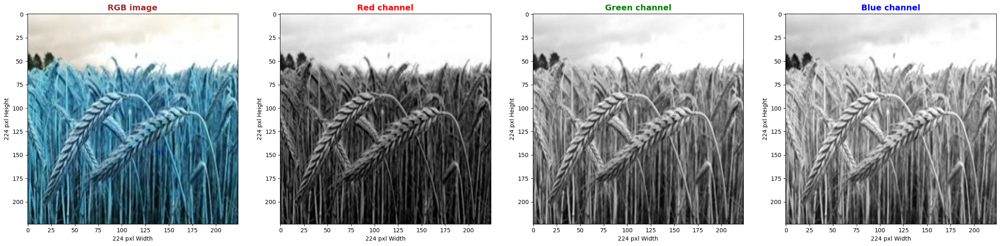

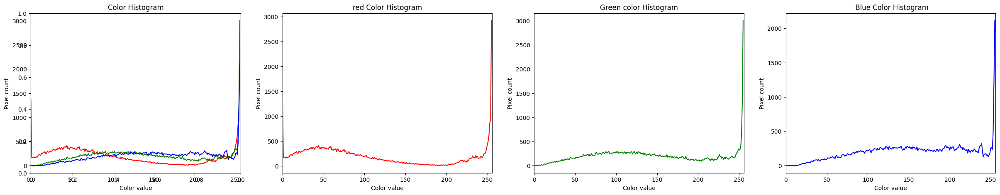

In [139]:
row_px = 150
col_px = 100
image_pixel_analysis(df_wheat.iloc[idx_]["path"],df_wheat.iloc[idx_]["crop"],row_px,col_px)

-------------------------------------------------------------------------------------------------WHEAT--------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


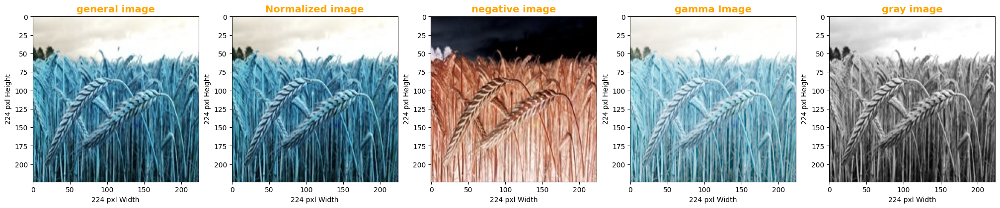

In [140]:
transformations_image(df_wheat.iloc[idx_]["path"],df_wheat.iloc[idx_]["crop"])

1. we have an 1000 images with 5 types of the crops.
4. all of the images are in RGB mode.
5. When changing the pixel values then entire image gets displayed differently with same format.
6. analyzing how channels are distributed.

Data splitting

In [141]:
# jute -0
# maize -1
# rice -2
# sugarcane-3
# wheat -4
from sklearn.model_selection import train_test_split
x = df["path"]
y = df["crop"]
X_train, X_test,y_train,y_test = train_test_split(x,y,test_size=0.1, random_state=42,stratify=y)
print("the shape of the train data : ",(X_train.shape,y_train.shape))
print("the shape of the test data : ",(X_test.shape,y_test.shape))

the shape of the train data :  ((899,), (899,))
the shape of the test data :  ((100,), (100,))


In [142]:
def class_distribution(y_train,y_test):
  """
    this function just gives the distribution of the dataset based on the class labels of the target after splitting the data
  """
  # it returns a dict, keys as class labels and values as the number of data points in that class
  train_class_distribution = y_train.value_counts()
  test_class_distribution = y_test.value_counts()

  my_colors = ['#b23850', '#3b8beb','#e7e3d4', '#c4dbf6', '#8590aa']
  train_class_distribution.plot(kind='bar', color=my_colors)
  plt.xlabel('target')
  plt.ylabel('Data points per Class')
  plt.title('Distribution of yi in train data')
  plt.grid()
  plt.show()

  # -(train_class_distribution.values): the minus sign will give us in decreasing order
  sorted_yi = np.argsort(-train_class_distribution.values)
  for i in sorted_yi:
    print('Number of data points in class', i+1, ':',train_class_distribution.values[i], '(', np.round((train_class_distribution.values[i]/y_train.shape[0]*100), 3), '%)')

  print('-'*80)
  my_colors = ['#b23850', '#3b8beb', '#e7e3d4', '#c4dbf6', '#8590aa']
  test_class_distribution.plot(kind='bar', color=my_colors)
  plt.xlabel('Class')
  plt.ylabel('Data points per Class')
  plt.title('Distribution of yi in test data')
  plt.grid()
  plt.show()

  sorted_yi = np.argsort(-test_class_distribution.values)
  for i in sorted_yi:
    print('Number of data points in class', i+1, ':',test_class_distribution.values[i], '(', np.round((test_class_distribution.values[i]/y_test.shape[0]*100), 3), '%)')


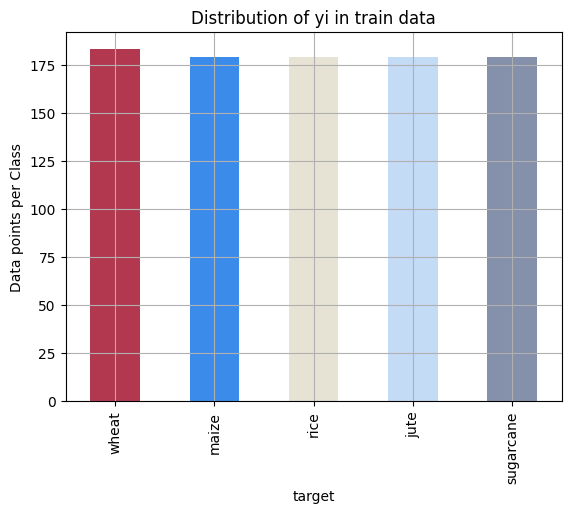

Number of data points in class 1 : 183 ( 20.356 %)
Number of data points in class 2 : 179 ( 19.911 %)
Number of data points in class 3 : 179 ( 19.911 %)
Number of data points in class 4 : 179 ( 19.911 %)
Number of data points in class 5 : 179 ( 19.911 %)
--------------------------------------------------------------------------------


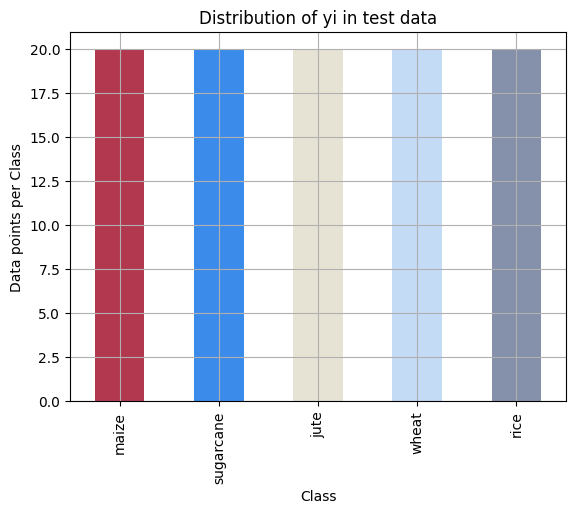

Number of data points in class 1 : 20 ( 20.0 %)
Number of data points in class 2 : 20 ( 20.0 %)
Number of data points in class 3 : 20 ( 20.0 %)
Number of data points in class 4 : 20 ( 20.0 %)
Number of data points in class 5 : 20 ( 20.0 %)


In [143]:
class_distribution(y_train,y_test)

all of the crops images are equally distributed

Roofline

In [144]:
df.iloc[0]

,0
path,/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg
crop,sugarcane
croplabel,3


In [145]:
#Assigning the path of an image file to the variable ip for processing
ip = "/kaggle/input/kag2/sugarcane/sugarcane037ahs.jpeg"

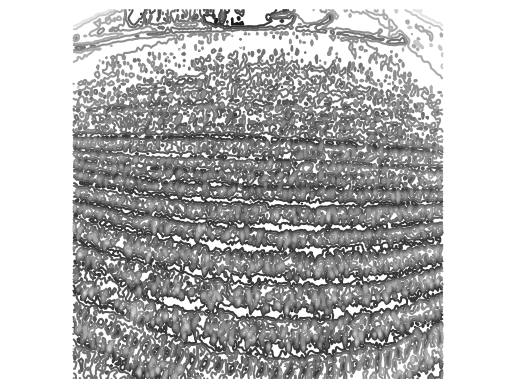

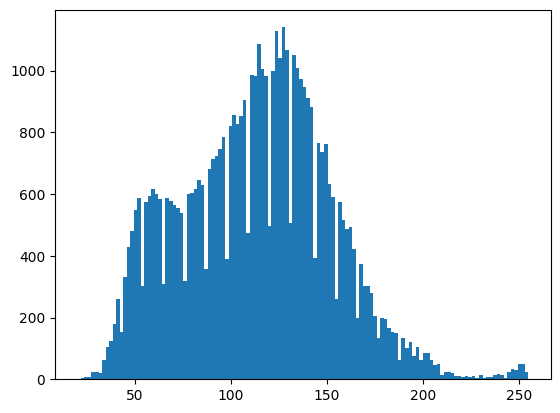

In [146]:
from PIL import Image
from pylab import *

# read image to array
im = array(Image.open(ip).convert('L'))

# create a new figure
figure()
# don't use colors
gray()
# show contours with origin upper left corner
contour(im, origin='image')
axis('equal')
axis('off')
figure()
hist(im.flatten(),128)
show()

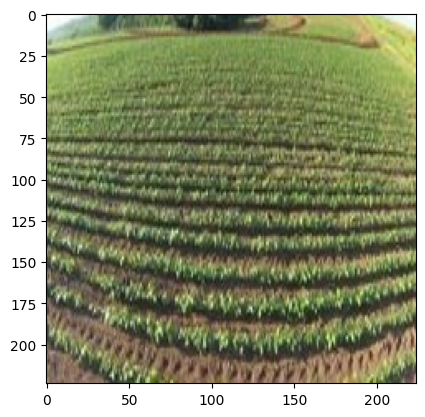

In [147]:
import skimage
# read original image, in full color
image = skimage.io.imread(ip)

# display the image
fig, ax = plt.subplots()
plt.imshow(image)
plt.show()


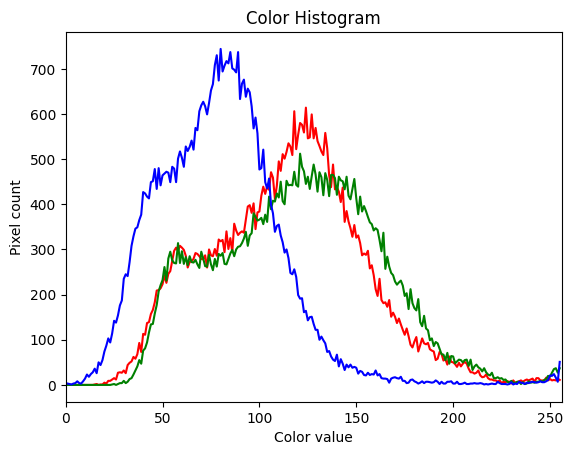

In [148]:
# tuple to select colors of each channel line
colors = ("red", "green", "blue")
channel_ids = (0, 1, 2)

# create the histogram plot, with three lines, one for each color
plt.figure()
plt.xlim([0, 256])
for channel_id, c in zip(channel_ids, colors):
    histogram, bin_edges = np.histogram(
        image[:, :, channel_id], bins=256, range=(0, 256)
    )
    plt.plot(bin_edges[0:-1], histogram, color=c)

plt.title("Color Histogram")
plt.xlabel("Color value")
plt.ylabel("Pixel count")

plt.show()


In [149]:
from skimage.io import imread
def image_analysis(image_path):
  im = Image.open(image_path)
  print(" summarize the basic details of the image...")
  print("="*50)
  print("The format of the image : ",im.format)
  print("The size of the image : ",im.size)
  print("The mode of the image : ",im.mode)

  print('Type of the image : ',type(im))
  print()
  # Use im.size to get the dimensions
  print('Shape of the image : {}'.format(im.size))
  # Access dimensions using indices on im.size
  print('Image Hight {}'.format(im.size[1]))
  print('Image Width {}'.format(im.size[0]))
  # Convert to NumPy array to get ndim
  print('Dimension of Image {}'.format(np.asarray(im).ndim))
  plt.imshow(im)
  plt.show()

  # load the image and convert into numpy array
  numpydata = asarray(im)
  #  shape
  print("shape of the image array",numpydata.shape)
  return None

 summarize the basic details of the image...
The format of the image :  JPEG
The size of the image :  (224, 224)
The mode of the image :  RGB
Type of the image :  <class 'PIL.JpegImagePlugin.JpegImageFile'>

Shape of the image : (224, 224)
Image Hight 224
Image Width 224
Dimension of Image 3


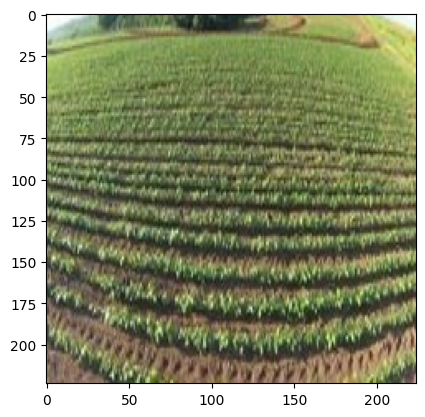

shape of the image array (224, 224, 3)


In [150]:
image_analysis(ip)

-----------------------------------------------------------------------------------------------SUGARCANE------------------------------------------------------------------------------------------------
shape of the given image :  (224, 224, 3)


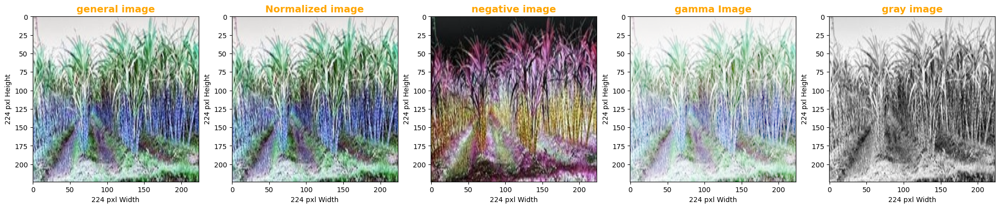

In [151]:
transformations_image(df.iloc[800]["path"],df.iloc[800]["crop"]) # 200,0,400,600,800

Base Modelling

In [152]:
import numpy as np
from numpy import asarray
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm # color map
import seaborn as sns

import os.path
from os import path

from google.colab import files

import matplotlib.pyplot as plt
import cv2 as cv
import cv2

# Import the necessary libraries
from PIL import Image
from skimage.io import imread

import tqdm
from tqdm import tqdm

from sklearn.preprocessing import OneHotEncoder,LabelEncoder

import warnings
warnings.filterwarnings("ignore")

!pip3 install pydot
!pip3 install graphviz
from tensorflow.keras.utils import plot_model

import tensorflow as tf
tf.keras.backend.clear_session()
#from tf.keras.optimizers import SGD
from tensorflow import keras
from tensorflow.keras import layers

In [153]:
from sklearn.preprocessing import OneHotEncoder
from scipy.sparse import csr_matrix

oh = OneHotEncoder()
y_train_oh = oh.fit_transform(y_train.values.reshape(-1,1))
y_train1 = csr_matrix.toarray(y_train_oh)

y_test_oh = oh.transform(y_test.values.reshape(-1,1))
y_test1 = csr_matrix.toarray(y_test_oh)
print("shape of the test data : ",y_test1.shape)
print("shape of the train data : ",y_train1.shape)

shape of the test data :  (100, 5)
shape of the train data :  (899, 5)


In [154]:
def dataset_creation_pipeline(dataset):
    flat = [] # create an empty list to store the array formatted image.
    for i in tqdm(dataset):
        img = plt.imread(i) # read the image
        img = img/255. # normalize the image
        flat.append(img) # append into the list
    flat_array =  np.array(flat) # convert the list into the array
    valued_img = flat_array.reshape(-1,224,224,3) # reshape the image into required format here I was used 224,224
    return valued_img


In [155]:
dx_train = dataset_creation_pipeline(X_train)
dx_test = dataset_creation_pipeline(X_test)

100%|██████████| 100/100 [00:00<00:00, 565.83it/s]


In [156]:
##checking the data type of the variable
type(dx_train)

numpy.ndarray

In [157]:
print("the no of trained images :",len(dx_train))
print("the shape of the  arrayed image : ",dx_train[0].shape)
print("the exmple image :")
print(dx_train[0])

the no of trained images : 899
the shape of the  arrayed image :  (224, 224, 3)
the exmple image :
[[[0.5372549  0.62745098 0.76078431]
  [0.5372549  0.62745098 0.76078431]
  [0.54117647 0.63137255 0.76470588]
  ...
  [0.58823529 0.65098039 0.78039216]
  [0.58431373 0.64705882 0.77647059]
  [0.58039216 0.64313725 0.77254902]]

 [[0.54117647 0.63137255 0.76470588]
  [0.54117647 0.63137255 0.76470588]
  [0.54509804 0.63529412 0.76862745]
  ...
  [0.58823529 0.65098039 0.78039216]
  [0.58431373 0.64705882 0.77647059]
  [0.58039216 0.64313725 0.77254902]]

 [[0.54509804 0.63529412 0.76862745]
  [0.54509804 0.63529412 0.76862745]
  [0.54901961 0.63921569 0.77254902]
  ...
  [0.58823529 0.65098039 0.78039216]
  [0.58431373 0.64705882 0.77647059]
  [0.58039216 0.64313725 0.77254902]]

 ...

 [[0.05098039 0.00392157 0.01176471]
  [0.0627451  0.01568627 0.02352941]
  [0.07058824 0.03137255 0.02745098]
  ...
  [0.0627451  0.03137255 0.02352941]
  [0.10588235 0.07058824 0.0745098 ]
  [0.12941176 

In [158]:
print("the no of tested images :",len(dx_test))
print("the shape of the  arrayed image : ",dx_test[0].shape)
print("the exmple image :")
print(dx_test[0])

the no of tested images : 100
the shape of the  arrayed image :  (224, 224, 3)
the exmple image :
[[[0.65882353 0.63137255 0.28627451]
  [0.69019608 0.6627451  0.31764706]
  [0.71372549 0.69019608 0.34509804]
  ...
  [0.68235294 0.65882353 0.28235294]
  [0.68627451 0.6627451  0.28627451]
  [0.69019608 0.66666667 0.29019608]]

 [[0.6627451  0.63529412 0.29019608]
  [0.6745098  0.65098039 0.30588235]
  [0.68627451 0.6627451  0.31764706]
  ...
  [0.67843137 0.65490196 0.27843137]
  [0.68627451 0.6627451  0.28627451]
  [0.69019608 0.66666667 0.29019608]]

 [[0.69019608 0.66666667 0.32156863]
  [0.65490196 0.63137255 0.28627451]
  [0.63137255 0.60784314 0.2627451 ]
  ...
  [0.67058824 0.64705882 0.27058824]
  [0.6745098  0.65098039 0.2745098 ]
  [0.67843137 0.65490196 0.27843137]]

 ...

 [[0.16470588 0.27058824 0.0627451 ]
  [0.24705882 0.35294118 0.14509804]
  [0.23137255 0.3372549  0.12156863]
  ...
  [0.18039216 0.24705882 0.0745098 ]
  [0.12156863 0.18039216 0.01176471]
  [0.09019608 0

In [159]:
def data_pipeline(imagepath,model ,label=[-1]):
    """
    it takes the image path and the model as input and gives the label of the image
    """
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    pred_x = dataset_creation_pipeline([imagepath]) # data_pipeline model is used to generate the numpy data of the given image
    prediction = model.predict(pred_x) # by using the model predict the output.
    pred = np.argmax(prediction[0]) # take the maximum probability value
    plt.imshow(plt.imread(imagepath)) # plot the given image

    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))

In [160]:
from sklearn.model_selection import train_test_split
x = df["path"]
y = df["crop"]
#df1 = df[['path', 'croplabel']] # takes only the image and mask values
X_train, X_test,y_train,y_test = train_test_split(x,y,test_size=0.11, random_state=42,stratify=y)#dataset is less so takes the 90-10 ratio.
print("the shape of the train data : ",(X_train.shape,y_train.shape))
print("the shape of the test data : ",(X_test.shape,y_test.shape))

the shape of the train data :  ((889,), (889,))
the shape of the test data :  ((110,), (110,))


In [161]:
from sklearn.preprocessing import OneHotEncoder
from scipy.sparse import csr_matrix

oh = OneHotEncoder()
y_train_oh = oh.fit_transform(y_train.values.reshape(-1,1))
y_train1 = csr_matrix.toarray(y_train_oh)

y_test_oh = oh.transform(y_test.values.reshape(-1,1))
y_test1 = csr_matrix.toarray(y_test_oh)
print("shape of the test data : ",y_test1.shape)
print("shape of the train data : ",y_train1.shape)

shape of the test data :  (110, 5)
shape of the train data :  (889, 5)


In [162]:
def dataset_creation_pipeline(dataset):
    flat = [] #to store the array formatted image.
    for i in tqdm(dataset):
        img = plt.imread(i)
        img = img/255. # normalize the image
        flat.append(img)
    flat_array =  np.array(flat)
    valued_img = flat_array.reshape(-1,224,224,3)
    return valued_img

In [163]:
# dataset be can created from the given image paths
dx_train = dataset_creation_pipeline(X_train)
dx_test = dataset_creation_pipeline(X_test)

100%|██████████| 110/110 [00:00<00:00, 115.32it/s]


In [164]:
#Resize training images to 224x224
resized_dx_train = np.zeros((dx_train.shape[0], 224, 224, 3))
for i in range(dx_train.shape[0]):
    resized_dx_train[i] = cv2.resize(dx_train[i], (224, 224))

# Resize test images to 224x224
resized_dx_test = np.zeros((dx_test.shape[0], 224, 224, 3))
for i in range(dx_test.shape[0]):
    resized_dx_test[i] = cv2.resize(dx_test[i], (224, 224))

# Normalize training and test images
resized_dx_train = resized_dx_train / 255.0
resized_dx_test = resized_dx_test / 255.0


KNN Accuracy: 0.7078651685393258
Random Forest Accuracy: 0.9213483146067416
SVM Accuracy: 0.9044943820224719
KNN Confusion Matrix:
 [[33  0  1  0  1]
 [ 8 17  7  8  3]
 [ 0  2 22  0  3]
 [ 1  2  9 26  0]
 [ 2  4  1  0 28]]
Random Forest Confusion Matrix:
 [[33  0  1  1  0]
 [ 2 36  0  2  3]
 [ 1  0 26  0  0]
 [ 1  2  1 34  0]
 [ 0  0  0  0 35]]
SVM Confusion Matrix:
 [[34  0  0  0  1]
 [ 2 33  5  2  1]
 [ 0  1 26  0  0]
 [ 0  3  2 33  0]
 [ 0  0  0  0 35]]


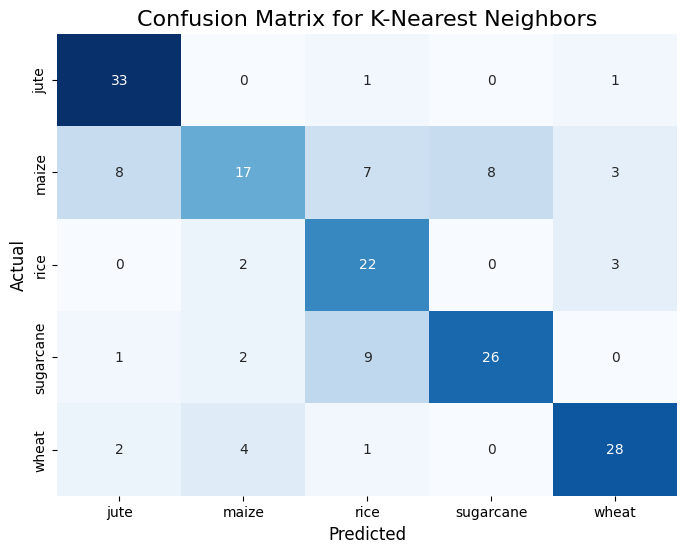

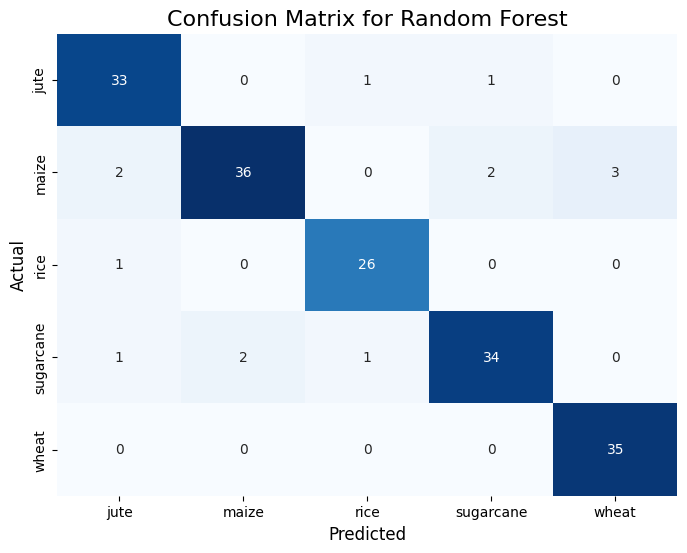

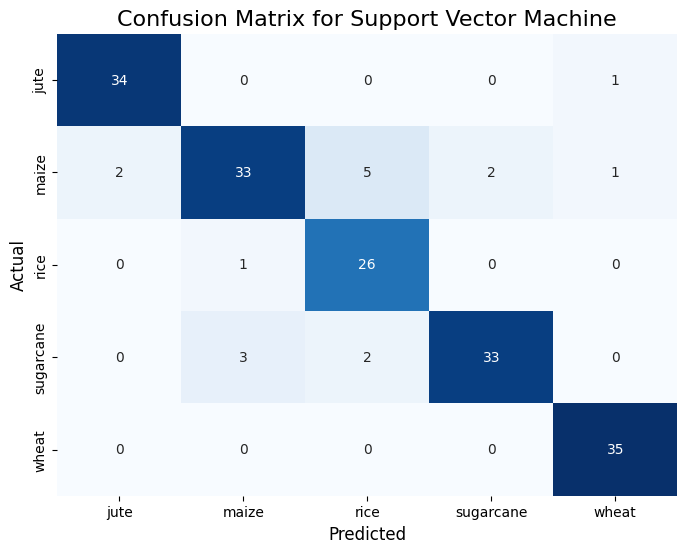

In [165]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Flatten image data
x_train_flat = resized_dx_train.reshape(resized_dx_train.shape[0], -1)
x_test_flat = resized_dx_test.reshape(resized_dx_test.shape[0], -1)

# Train-test split (80-20)
x_train, x_val, y_train, y_val = train_test_split(x_train_flat, np.argmax(y_train1, axis=1), test_size=0.2, random_state=42)

#K-Nearest Neighbors model
knn_model = KNeighborsClassifier(n_neighbors=5)
knn_model.fit(x_train, y_train)
y_pred_knn = knn_model.predict(x_val)

#Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(x_train, y_train)
y_pred_rf = rf_model.predict(x_val)

#Support Vector Machine model
svm_model = SVC(random_state=42)
svm_model.fit(x_train, y_train)
y_pred_svm = svm_model.predict(x_val)

#Evaluate the models
print("KNN Accuracy:", accuracy_score(y_val, y_pred_knn))
print("Random Forest Accuracy:", accuracy_score(y_val, y_pred_rf))
print("SVM Accuracy:", accuracy_score(y_val, y_pred_svm))
print("KNN Confusion Matrix:\n", confusion_matrix(y_val, y_pred_knn))
print("Random Forest Confusion Matrix:\n", confusion_matrix(y_val, y_pred_rf))
print("SVM Confusion Matrix:\n", confusion_matrix(y_val, y_pred_svm))

# Confusion matrices
cm_knn = confusion_matrix(y_val, y_pred_knn)
cm_rf = confusion_matrix(y_val, y_pred_rf)
cm_svm = confusion_matrix(y_val, y_pred_svm)

# Crop class labels
class_labels = ["jute", "maize", "rice", "sugarcane", "wheat"]

# Function to plot confusion matrix with class labels
def plot_confusion_matrix(cm, model_name, class_labels):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_labels, yticklabels=class_labels, cbar=False)
    plt.title(f'Confusion Matrix for {model_name}', fontsize=16)
    plt.xlabel('Predicted', fontsize=12)
    plt.ylabel('Actual', fontsize=12)
    plt.show()

# Plot for KNN
plot_confusion_matrix(cm_knn, 'K-Nearest Neighbors', class_labels)

# Plot for Random Forest
plot_confusion_matrix(cm_rf, 'Random Forest', class_labels)

# Plot for SVM
plot_confusion_matrix(cm_svm, 'Support Vector Machine', class_labels)


The Random Forest classifier achieved the highest accuracy of 92.13%, significantly outperforming both the Support Vector Machine (SVM) at 90.45% and the K-Nearest Neighbors (KNN) at 70.79%.
This indicates that Random Forest is better at correctly classifying the crop images in this dataset.

In [166]:
import pickle
x_train, x_val, y_train, y_val = train_test_split(
x_train_flat, y_train1.argmax(axis=1), test_size=0.2, random_state=42)
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(x_train, y_train)
y_pred_rf = rf_model.predict(x_val)

if not os.path.exists('/kaggle/working'):
    os.makedirs('/kaggle/working')

# Save the model to a file
with open('/kaggle/working/best_random_forest_model.pkl', 'wb') as file:
    pickle.dump(rf_model, file)

Image augmentation for data optimization

In [167]:
import numpy as np
import pandas as pd
import cv2
import os
import pickle
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
!pip install tensorflow
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.applications import VGG16
from keras.models import Model
from tqdm import tqdm

# Load dataset
x = df["path"]
y = df["crop"]

# Encode labels
oh = OneHotEncoder(sparse_output=False)
y_encoded = oh.fit_transform(y.values.reshape(-1, 1))

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(x, y_encoded, test_size=0.11, random_state=42, stratify=y)


In [168]:
if os.path.exists('/kaggle/working/X_train_features_augmented.npy') and os.path.exists('/kaggle/working/X_test_features_augmented.npy'):
    # Load features from file
    X_train_features = np.load('/kaggle/working/X_train_features_augmented.npy')
    X_test_features = np.load('/kaggle/working/X_test_features_augmented.npy')
else:
    # Image Augmentation
    datagen = ImageDataGenerator(
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    # Function to preprocess and extract features using VGG16
    def extract_features(image_paths):
        base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
        model = Model(inputs=base_model.input, outputs=base_model.output)

        features = []
        for path in tqdm(image_paths):
            img = cv2.imread(path)
            img = cv2.resize(img, (224, 224))
            img = np.expand_dims(img, axis=0)
            img = img / 255.0  # Normalize
            feature = model.predict(img)
            features.append(feature.flatten())

        return np.array(features)

    # Extract features
    X_train_features = extract_features(X_train)
    X_test_features = extract_features(X_test)

    # Save features to file for future use
    np.save('/kaggle/working/X_train_features_augmented.npy', X_train_features)
    np.save('/kaggle/working/X_test_features_augmented.npy', X_test_features)


  0%|          | 0/889 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  0%|          | 1/889 [00:01<21:09,  1.43s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 933ms/step


  0%|          | 2/889 [00:02<17:39,  1.19s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 986ms/step


  0%|          | 3/889 [00:03<17:12,  1.16s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 968ms/step


  0%|          | 4/889 [00:04<16:58,  1.15s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 950ms/step


  1%|          | 5/889 [00:05<16:20,  1.11s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  1%|          | 6/889 [00:06<16:16,  1.11s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


  1%|          | 7/889 [00:08<19:28,  1.32s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


  1%|          | 8/889 [00:10<23:02,  1.57s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


  1%|          | 9/889 [00:12<25:03,  1.71s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  1%|          | 10/889 [00:14<23:30,  1.60s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  1%|          | 11/889 [00:15<22:28,  1.54s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  1%|▏         | 12/889 [00:16<21:02,  1.44s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  1%|▏         | 13/889 [00:17<20:01,  1.37s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  2%|▏         | 14/889 [00:19<19:32,  1.34s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  2%|▏         | 15/889 [00:20<19:00,  1.31s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  2%|▏         | 16/889 [00:21<18:15,  1.26s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  2%|▏         | 17/889 [00:22<18:24,  1.27s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


  2%|▏         | 18/889 [00:25<22:22,  1.54s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


  2%|▏         | 19/889 [00:27<25:50,  1.78s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  2%|▏         | 20/889 [00:28<25:05,  1.73s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 906ms/step


  2%|▏         | 21/889 [00:30<21:56,  1.52s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 971ms/step


  2%|▏         | 22/889 [00:31<21:28,  1.49s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step


  3%|▎         | 23/889 [00:32<19:17,  1.34s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 24/889 [00:33<18:19,  1.27s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 25/889 [00:34<17:59,  1.25s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 26/889 [00:35<17:38,  1.23s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 945ms/step


  3%|▎         | 27/889 [00:37<18:14,  1.27s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 28/889 [00:38<18:03,  1.26s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 29/889 [00:40<19:59,  1.39s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 30/889 [00:41<21:31,  1.50s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  3%|▎         | 31/889 [00:43<21:06,  1.48s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  4%|▎         | 32/889 [00:44<20:25,  1.43s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 956ms/step


  4%|▎         | 33/889 [00:45<18:44,  1.31s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


  4%|▍         | 34/889 [00:46<17:48,  1.25s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 936ms/step


  4%|▍         | 35/889 [00:47<16:48,  1.18s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


  4%|▍         | 36/889 [00:48<14:23,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


  4%|▍         | 37/889 [00:49<12:39,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


  4%|▍         | 38/889 [00:49<11:26,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


  4%|▍         | 39/889 [00:50<10:37,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


  4%|▍         | 40/889 [00:51<10:22,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


  5%|▍         | 41/889 [00:51<09:52,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 883ms/step


  5%|▍         | 42/889 [00:52<10:54,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 977ms/step


  5%|▍         | 43/889 [00:53<12:08,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 873ms/step


  5%|▍         | 44/889 [00:54<12:32,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  5%|▌         | 45/889 [00:55<13:38,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


  5%|▌         | 46/889 [00:56<12:58,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


  5%|▌         | 47/889 [00:57<11:35,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


  5%|▌         | 48/889 [00:57<10:42,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


  6%|▌         | 49/889 [00:58<10:26,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


  6%|▌         | 50/889 [00:59<10:13,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


  6%|▌         | 51/889 [00:59<09:45,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


  6%|▌         | 52/889 [01:00<09:21,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


  6%|▌         | 53/889 [01:01<09:05,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


  6%|▌         | 54/889 [01:01<09:16,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


  6%|▌         | 55/889 [01:02<09:04,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


  6%|▋         | 56/889 [01:02<08:56,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


  6%|▋         | 57/889 [01:03<08:45,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


  7%|▋         | 58/889 [01:04<08:45,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


  7%|▋         | 59/889 [01:04<08:35,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


  7%|▋         | 60/889 [01:05<08:37,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


  7%|▋         | 61/889 [01:06<08:53,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 878ms/step


  7%|▋         | 62/889 [01:07<10:05,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 997ms/step


  7%|▋         | 63/889 [01:08<11:30,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 850ms/step


  7%|▋         | 64/889 [01:09<13:43,  1.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step


  7%|▋         | 65/889 [01:10<12:38,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


  7%|▋         | 66/889 [01:10<11:19,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


  8%|▊         | 67/889 [01:11<10:46,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


  8%|▊         | 68/889 [01:12<10:03,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


  8%|▊         | 69/889 [01:12<09:30,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


  8%|▊         | 70/889 [01:13<09:12,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


  8%|▊         | 71/889 [01:14<08:55,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step


  8%|▊         | 72/889 [01:14<08:58,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


  8%|▊         | 73/889 [01:15<08:45,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


  8%|▊         | 74/889 [01:15<08:39,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


  8%|▊         | 75/889 [01:16<08:32,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


  9%|▊         | 76/889 [01:17<08:26,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


  9%|▊         | 77/889 [01:17<08:25,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


  9%|▉         | 78/889 [01:18<08:42,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


  9%|▉         | 79/889 [01:19<08:32,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


  9%|▉         | 80/889 [01:19<08:28,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 876ms/step


  9%|▉         | 81/889 [01:20<09:43,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 993ms/step


  9%|▉         | 82/889 [01:21<11:09,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 875ms/step


  9%|▉         | 83/889 [01:22<11:39,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  9%|▉         | 84/889 [01:23<12:52,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 771ms/step


 10%|▉         | 85/889 [01:24<12:28,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 10%|▉         | 86/889 [01:25<11:12,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 10%|▉         | 87/889 [01:25<10:18,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 10%|▉         | 88/889 [01:26<09:36,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 10%|█         | 89/889 [01:27<09:12,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 10%|█         | 90/889 [01:27<08:52,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 10%|█         | 91/889 [01:28<08:39,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 10%|█         | 92/889 [01:29<08:48,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 10%|█         | 93/889 [01:29<08:33,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 11%|█         | 94/889 [01:30<08:26,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 11%|█         | 95/889 [01:30<08:16,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 11%|█         | 96/889 [01:31<08:17,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 11%|█         | 97/889 [01:32<08:15,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 11%|█         | 98/889 [01:32<08:08,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 11%|█         | 99/889 [01:33<08:26,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 11%|█         | 100/889 [01:34<08:15,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step


 11%|█▏        | 101/889 [01:34<08:30,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 972ms/step


 11%|█▏        | 102/889 [01:35<10:04,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 971ms/step


 12%|█▏        | 103/889 [01:36<11:14,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 12%|█▏        | 104/889 [01:37<12:14,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 12%|█▏        | 105/889 [01:39<12:54,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 12%|█▏        | 106/889 [01:39<11:28,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 12%|█▏        | 107/889 [01:40<10:22,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 12%|█▏        | 108/889 [01:40<09:43,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 12%|█▏        | 109/889 [01:41<09:08,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 12%|█▏        | 110/889 [01:42<08:48,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 12%|█▏        | 111/889 [01:42<08:33,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 13%|█▎        | 112/889 [01:43<08:19,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 13%|█▎        | 113/889 [01:43<08:14,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


 13%|█▎        | 114/889 [01:44<08:12,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 13%|█▎        | 115/889 [01:45<08:07,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 13%|█▎        | 116/889 [01:45<08:05,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 13%|█▎        | 117/889 [01:46<07:57,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 13%|█▎        | 118/889 [01:47<07:57,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 13%|█▎        | 119/889 [01:47<07:49,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 13%|█▎        | 120/889 [01:48<07:50,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 14%|█▎        | 121/889 [01:48<08:10,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 846ms/step


 14%|█▎        | 122/889 [01:49<09:11,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 950ms/step


 14%|█▍        | 123/889 [01:50<10:26,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 870ms/step


 14%|█▍        | 124/889 [01:51<10:55,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 14%|█▍        | 125/889 [01:53<11:53,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step


 14%|█▍        | 126/889 [01:54<12:18,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 14%|█▍        | 127/889 [01:54<10:54,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 14%|█▍        | 128/889 [01:55<09:55,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 15%|█▍        | 129/889 [01:55<09:15,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 15%|█▍        | 130/889 [01:56<08:51,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 15%|█▍        | 131/889 [01:57<08:30,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 15%|█▍        | 132/889 [01:57<08:17,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 15%|█▍        | 133/889 [01:58<08:07,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 15%|█▌        | 134/889 [01:58<08:05,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 15%|█▌        | 135/889 [01:59<07:57,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 15%|█▌        | 136/889 [02:00<07:52,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 913ms/step


 15%|█▌        | 137/889 [02:01<09:12,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 790ms/step


 16%|█▌        | 138/889 [02:02<10:18,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 916ms/step


 16%|█▌        | 139/889 [02:03<11:46,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


 16%|█▌        | 140/889 [02:05<15:03,  1.21s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 16%|█▌        | 141/889 [02:06<15:23,  1.23s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 16%|█▌        | 142/889 [02:07<15:15,  1.23s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 995ms/step


 16%|█▌        | 143/889 [02:08<14:50,  1.19s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 16%|█▌        | 144/889 [02:10<15:47,  1.27s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


 16%|█▋        | 145/889 [02:11<15:10,  1.22s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step


 16%|█▋        | 146/889 [02:12<15:43,  1.27s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 17%|█▋        | 147/889 [02:13<13:14,  1.07s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 17%|█▋        | 148/889 [02:14<11:49,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step


 17%|█▋        | 149/889 [02:14<10:40,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 17%|█▋        | 150/889 [02:15<09:44,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 17%|█▋        | 151/889 [02:16<09:02,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 17%|█▋        | 152/889 [02:16<08:34,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 17%|█▋        | 153/889 [02:17<08:15,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 17%|█▋        | 154/889 [02:17<08:01,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 17%|█▋        | 155/889 [02:18<07:49,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 18%|█▊        | 156/889 [02:19<07:45,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 18%|█▊        | 157/889 [02:19<07:57,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 18%|█▊        | 158/889 [02:20<07:49,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 18%|█▊        | 159/889 [02:21<07:43,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 888ms/step


 18%|█▊        | 160/889 [02:21<08:53,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 998ms/step


 18%|█▊        | 161/889 [02:23<10:09,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 875ms/step


 18%|█▊        | 162/889 [02:23<10:34,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 18%|█▊        | 163/889 [02:25<11:39,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 877ms/step


 18%|█▊        | 164/889 [02:26<11:35,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 19%|█▊        | 165/889 [02:26<10:17,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


 19%|█▊        | 166/889 [02:27<09:28,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 19%|█▉        | 167/889 [02:27<08:50,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 19%|█▉        | 168/889 [02:28<08:46,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 19%|█▉        | 169/889 [02:29<08:24,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 19%|█▉        | 170/889 [02:29<08:06,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 19%|█▉        | 171/889 [02:30<08:10,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 19%|█▉        | 172/889 [02:31<07:56,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 19%|█▉        | 173/889 [02:31<07:45,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 20%|█▉        | 174/889 [02:32<07:35,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 20%|█▉        | 175/889 [02:33<07:28,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 20%|█▉        | 176/889 [02:33<07:22,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 20%|█▉        | 177/889 [02:34<07:21,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 20%|██        | 178/889 [02:34<07:20,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 20%|██        | 179/889 [02:35<07:19,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step


 20%|██        | 180/889 [02:36<07:42,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 961ms/step


 20%|██        | 181/889 [02:37<09:05,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step


 20%|██        | 182/889 [02:38<10:07,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 978ms/step


 21%|██        | 183/889 [02:39<10:51,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 716ms/step


 21%|██        | 184/889 [02:40<10:32,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 21%|██        | 185/889 [02:40<09:34,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


 21%|██        | 186/889 [02:41<08:45,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 21%|██        | 187/889 [02:42<08:19,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 21%|██        | 188/889 [02:42<07:58,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 21%|██▏       | 189/889 [02:43<07:43,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 21%|██▏       | 190/889 [02:43<07:33,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 21%|██▏       | 191/889 [02:44<07:22,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step


 22%|██▏       | 192/889 [02:45<07:27,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 22%|██▏       | 193/889 [02:45<07:21,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


 22%|██▏       | 194/889 [02:46<07:11,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


 22%|██▏       | 195/889 [02:47<07:13,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 22%|██▏       | 196/889 [02:47<07:08,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 22%|██▏       | 197/889 [02:48<07:08,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 22%|██▏       | 198/889 [02:48<07:04,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 22%|██▏       | 199/889 [02:49<07:01,  1.64it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step


 22%|██▏       | 200/889 [02:50<07:16,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 965ms/step


 23%|██▎       | 201/889 [02:51<08:42,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 964ms/step


 23%|██▎       | 202/889 [02:52<10:49,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 990ms/step


 23%|██▎       | 203/889 [02:54<12:15,  1.07s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 23%|██▎       | 204/889 [02:54<10:40,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 23%|██▎       | 205/889 [02:55<09:32,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 23%|██▎       | 206/889 [02:55<08:45,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 23%|██▎       | 207/889 [02:56<08:14,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 23%|██▎       | 208/889 [02:57<08:09,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 24%|██▎       | 209/889 [02:57<07:45,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 24%|██▎       | 210/889 [02:58<07:30,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 24%|██▎       | 211/889 [02:59<07:20,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 24%|██▍       | 212/889 [02:59<07:13,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 24%|██▍       | 213/889 [03:00<07:06,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 24%|██▍       | 214/889 [03:00<07:05,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 24%|██▍       | 215/889 [03:01<07:00,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 24%|██▍       | 216/889 [03:02<07:00,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 24%|██▍       | 217/889 [03:02<06:57,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 25%|██▍       | 218/889 [03:03<06:56,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 25%|██▍       | 219/889 [03:03<06:55,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 926ms/step


 25%|██▍       | 220/889 [03:04<08:10,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 962ms/step


 25%|██▍       | 221/889 [03:05<09:13,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 913ms/step


 25%|██▍       | 222/889 [03:07<09:50,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 25%|██▌       | 223/889 [03:08<10:43,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 805ms/step


 25%|██▌       | 224/889 [03:09<10:29,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 25%|██▌       | 225/889 [03:09<09:17,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 25%|██▌       | 226/889 [03:10<08:48,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 26%|██▌       | 227/889 [03:10<08:09,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 26%|██▌       | 228/889 [03:11<07:45,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


 26%|██▌       | 229/889 [03:12<07:42,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 26%|██▌       | 230/889 [03:12<07:42,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 26%|██▌       | 231/889 [03:13<07:40,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 26%|██▌       | 232/889 [03:14<07:24,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 26%|██▌       | 233/889 [03:14<07:08,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 26%|██▋       | 234/889 [03:15<07:05,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 26%|██▋       | 235/889 [03:16<06:56,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 27%|██▋       | 236/889 [03:16<06:49,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 27%|██▋       | 237/889 [03:17<06:48,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 27%|██▋       | 238/889 [03:17<06:42,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 27%|██▋       | 239/889 [03:18<06:40,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 781ms/step


 27%|██▋       | 240/889 [03:19<07:26,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 986ms/step


 27%|██▋       | 241/889 [03:20<08:42,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 917ms/step


 27%|██▋       | 242/889 [03:21<09:19,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 27%|██▋       | 243/889 [03:22<10:08,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 957ms/step


 27%|██▋       | 244/889 [03:23<10:30,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 28%|██▊       | 245/889 [03:24<09:17,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 28%|██▊       | 246/889 [03:24<08:28,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 28%|██▊       | 247/889 [03:25<07:51,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 28%|██▊       | 248/889 [03:26<07:28,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 28%|██▊       | 249/889 [03:26<07:09,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 28%|██▊       | 250/889 [03:27<06:58,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 28%|██▊       | 251/889 [03:27<06:50,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 28%|██▊       | 252/889 [03:28<06:44,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 28%|██▊       | 253/889 [03:29<06:43,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 29%|██▊       | 254/889 [03:29<06:39,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 29%|██▊       | 255/889 [03:30<06:37,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 29%|██▉       | 256/889 [03:31<06:36,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 29%|██▉       | 257/889 [03:31<06:31,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 29%|██▉       | 258/889 [03:32<06:31,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 29%|██▉       | 259/889 [03:32<06:27,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 29%|██▉       | 260/889 [03:33<06:26,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 933ms/step


 29%|██▉       | 261/889 [03:34<07:38,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 963ms/step


 29%|██▉       | 262/889 [03:35<08:38,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 876ms/step


 30%|██▉       | 263/889 [03:36<09:03,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 942ms/step


 30%|██▉       | 264/889 [03:37<09:33,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 30%|██▉       | 265/889 [03:38<08:40,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 30%|██▉       | 266/889 [03:38<08:16,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 30%|███       | 267/889 [03:39<07:42,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 30%|███       | 268/889 [03:40<07:16,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 30%|███       | 269/889 [03:40<06:57,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 30%|███       | 270/889 [03:41<06:44,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 30%|███       | 271/889 [03:41<06:36,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 31%|███       | 272/889 [03:42<06:29,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 31%|███       | 273/889 [03:43<06:24,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 31%|███       | 274/889 [03:43<06:36,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 31%|███       | 275/889 [03:44<06:26,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


 31%|███       | 276/889 [03:45<06:31,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 31%|███       | 277/889 [03:45<06:25,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 31%|███▏      | 278/889 [03:46<06:40,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 31%|███▏      | 279/889 [03:47<06:34,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 31%|███▏      | 280/889 [03:47<06:30,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step


 32%|███▏      | 281/889 [03:48<07:42,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 957ms/step


 32%|███▏      | 282/889 [03:50<09:36,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step    


 32%|███▏      | 283/889 [03:51<09:59,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step


 32%|███▏      | 284/889 [03:52<10:08,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 32%|███▏      | 285/889 [03:52<08:55,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 32%|███▏      | 286/889 [03:53<08:05,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 32%|███▏      | 287/889 [03:54<07:31,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 32%|███▏      | 288/889 [03:54<07:04,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 33%|███▎      | 289/889 [03:55<07:02,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 33%|███▎      | 290/889 [03:56<06:44,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 33%|███▎      | 291/889 [03:56<06:31,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 33%|███▎      | 292/889 [03:57<06:24,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 33%|███▎      | 293/889 [03:57<06:18,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 33%|███▎      | 294/889 [03:58<06:15,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 33%|███▎      | 295/889 [03:59<06:11,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 33%|███▎      | 296/889 [03:59<06:09,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 33%|███▎      | 297/889 [04:00<06:06,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 34%|███▎      | 298/889 [04:00<06:02,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 34%|███▎      | 299/889 [04:01<06:04,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 34%|███▎      | 300/889 [04:02<06:03,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 916ms/step


 34%|███▍      | 301/889 [04:03<07:08,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 981ms/step


 34%|███▍      | 302/889 [04:04<08:07,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 875ms/step


 34%|███▍      | 303/889 [04:05<08:31,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 34%|███▍      | 304/889 [04:06<09:21,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 710ms/step


 34%|███▍      | 305/889 [04:07<08:53,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 34%|███▍      | 306/889 [04:07<08:00,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 35%|███▍      | 307/889 [04:08<07:20,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 35%|███▍      | 308/889 [04:09<06:55,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 35%|███▍      | 309/889 [04:09<06:34,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 35%|███▍      | 310/889 [04:10<06:25,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 35%|███▍      | 311/889 [04:10<06:16,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 35%|███▌      | 312/889 [04:11<06:07,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 35%|███▌      | 313/889 [04:12<06:18,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 35%|███▌      | 314/889 [04:12<06:08,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 35%|███▌      | 315/889 [04:13<06:21,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 36%|███▌      | 316/889 [04:14<06:27,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 36%|███▌      | 317/889 [04:14<06:14,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step


 36%|███▌      | 318/889 [04:15<06:13,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


 36%|███▌      | 319/889 [04:16<06:09,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 36%|███▌      | 320/889 [04:16<06:02,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step


 36%|███▌      | 321/889 [04:17<07:06,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


 36%|███▌      | 322/889 [04:19<09:51,  1.04s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


 36%|███▋      | 323/889 [04:21<12:58,  1.38s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 36%|███▋      | 324/889 [04:22<12:57,  1.38s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 989ms/step


 37%|███▋      | 325/889 [04:24<12:18,  1.31s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 326/889 [04:25<12:42,  1.35s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 327/889 [04:26<12:05,  1.29s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 328/889 [04:28<12:33,  1.34s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 329/889 [04:29<12:40,  1.36s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 330/889 [04:30<12:16,  1.32s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 331/889 [04:32<12:11,  1.31s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


 37%|███▋      | 332/889 [04:34<14:10,  1.53s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


 37%|███▋      | 333/889 [04:36<15:32,  1.68s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 993ms/step


 38%|███▊      | 334/889 [04:37<14:10,  1.53s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 38%|███▊      | 335/889 [04:37<11:34,  1.25s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 38%|███▊      | 336/889 [04:38<09:47,  1.06s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 38%|███▊      | 337/889 [04:39<08:32,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 38%|███▊      | 338/889 [04:39<07:41,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 38%|███▊      | 339/889 [04:40<07:04,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 38%|███▊      | 340/889 [04:41<06:38,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 38%|███▊      | 341/889 [04:41<06:19,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 38%|███▊      | 342/889 [04:42<06:19,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 39%|███▊      | 343/889 [04:43<06:07,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 39%|███▊      | 344/889 [04:43<05:58,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 39%|███▉      | 345/889 [04:44<06:03,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 39%|███▉      | 346/889 [04:44<05:55,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


 39%|███▉      | 347/889 [04:45<05:51,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 39%|███▉      | 348/889 [04:46<05:47,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 39%|███▉      | 349/889 [04:46<05:43,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 942ms/step


 39%|███▉      | 350/889 [04:47<06:47,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 971ms/step


 39%|███▉      | 351/889 [04:48<07:35,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 939ms/step


 40%|███▉      | 352/889 [04:49<08:06,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 972ms/step


 40%|███▉      | 353/889 [04:51<09:26,  1.06s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 40%|███▉      | 354/889 [04:51<08:15,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 40%|███▉      | 355/889 [04:52<07:23,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 40%|████      | 356/889 [04:53<06:50,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 40%|████      | 357/889 [04:53<06:22,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 40%|████      | 358/889 [04:54<06:07,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 40%|████      | 359/889 [04:55<05:53,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 40%|████      | 360/889 [04:55<05:45,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 41%|████      | 361/889 [04:56<05:40,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 41%|████      | 362/889 [04:56<05:35,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 41%|████      | 363/889 [04:57<05:32,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 41%|████      | 364/889 [04:58<05:30,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 41%|████      | 365/889 [04:58<05:42,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 41%|████      | 366/889 [04:59<05:49,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 41%|████▏     | 367/889 [05:00<05:40,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 41%|████▏     | 368/889 [05:00<05:33,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step


 42%|████▏     | 369/889 [05:01<05:40,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 977ms/step


 42%|████▏     | 370/889 [05:02<07:30,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 914ms/step


 42%|████▏     | 371/889 [05:03<07:51,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 42%|████▏     | 372/889 [05:05<08:30,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 877ms/step


 42%|████▏     | 373/889 [05:06<08:26,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 42%|████▏     | 374/889 [05:06<07:28,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 42%|████▏     | 375/889 [05:07<06:48,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 42%|████▏     | 376/889 [05:07<06:21,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 42%|████▏     | 377/889 [05:08<05:59,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 43%|████▎     | 378/889 [05:09<05:46,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 43%|████▎     | 379/889 [05:09<05:34,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 43%|████▎     | 380/889 [05:10<05:27,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 43%|████▎     | 381/889 [05:10<05:23,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 43%|████▎     | 382/889 [05:11<05:18,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 43%|████▎     | 383/889 [05:12<05:16,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 43%|████▎     | 384/889 [05:12<05:14,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 43%|████▎     | 385/889 [05:13<05:30,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 43%|████▎     | 386/889 [05:14<05:25,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 44%|████▎     | 387/889 [05:14<05:18,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 44%|████▎     | 388/889 [05:15<05:17,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 626ms/step


 44%|████▍     | 389/889 [05:16<05:30,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 973ms/step


 44%|████▍     | 390/889 [05:17<07:16,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 908ms/step


 44%|████▍     | 391/889 [05:18<08:29,  1.02s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step


 44%|████▍     | 392/889 [05:19<07:45,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 44%|████▍     | 393/889 [05:20<06:55,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 44%|████▍     | 394/889 [05:20<06:23,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step


 44%|████▍     | 395/889 [05:21<06:17,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 985ms/step


 45%|████▍     | 396/889 [05:22<07:02,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 962ms/step


 45%|████▍     | 397/889 [05:23<07:30,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 960ms/step


 45%|████▍     | 398/889 [05:24<07:52,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 45%|████▍     | 399/889 [05:25<08:17,  1.02s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 45%|████▍     | 400/889 [05:26<07:22,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 45%|████▌     | 401/889 [05:27<06:41,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 45%|████▌     | 402/889 [05:27<06:11,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 45%|████▌     | 403/889 [05:28<05:48,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 45%|████▌     | 404/889 [05:29<05:36,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 813ms/step


 46%|████▌     | 405/889 [05:29<06:01,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 975ms/step


 46%|████▌     | 406/889 [05:30<06:48,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 899ms/step


 46%|████▌     | 407/889 [05:31<07:07,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 46%|████▌     | 408/889 [05:33<07:39,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 46%|████▌     | 409/889 [05:34<08:00,  1.00s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 46%|████▌     | 410/889 [05:34<07:03,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 46%|████▌     | 411/889 [05:35<06:27,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 46%|████▋     | 412/889 [05:36<05:57,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 46%|████▋     | 413/889 [05:36<05:39,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 47%|████▋     | 414/889 [05:37<05:26,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 47%|████▋     | 415/889 [05:37<05:14,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 47%|████▋     | 416/889 [05:38<05:06,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 47%|████▋     | 417/889 [05:39<05:00,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 47%|████▋     | 418/889 [05:39<05:09,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 47%|████▋     | 419/889 [05:40<05:03,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 47%|████▋     | 420/889 [05:41<04:57,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 47%|████▋     | 421/889 [05:41<04:56,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 47%|████▋     | 422/889 [05:42<04:52,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 48%|████▊     | 423/889 [05:42<04:51,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 48%|████▊     | 424/889 [05:43<04:51,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 48%|████▊     | 425/889 [05:44<04:49,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 865ms/step


 48%|████▊     | 426/889 [05:45<05:35,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 941ms/step


 48%|████▊     | 427/889 [05:46<06:18,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 933ms/step


 48%|████▊     | 428/889 [05:47<06:44,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 48%|████▊     | 429/889 [05:48<07:22,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 752ms/step


 48%|████▊     | 430/889 [05:49<07:05,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 48%|████▊     | 431/889 [05:49<06:19,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 49%|████▊     | 432/889 [05:50<06:06,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 49%|████▊     | 433/889 [05:51<05:41,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 49%|████▉     | 434/889 [05:51<05:20,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 49%|████▉     | 435/889 [05:52<05:10,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 49%|████▉     | 436/889 [05:53<05:00,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 49%|████▉     | 437/889 [05:53<04:53,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 49%|████▉     | 438/889 [05:54<05:00,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 49%|████▉     | 439/889 [05:54<04:51,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 49%|████▉     | 440/889 [05:55<04:46,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 50%|████▉     | 441/889 [05:56<04:43,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 50%|████▉     | 442/889 [05:56<04:38,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 50%|████▉     | 443/889 [05:57<04:49,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 50%|████▉     | 444/889 [05:58<04:43,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 50%|█████     | 445/889 [05:58<04:41,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 747ms/step


 50%|█████     | 446/889 [05:59<05:05,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 50%|█████     | 447/889 [06:00<05:59,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 884ms/step


 50%|█████     | 448/889 [06:01<06:21,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 975ms/step


 51%|█████     | 449/889 [06:02<06:48,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 736ms/step


 51%|█████     | 450/889 [06:03<06:36,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 51%|█████     | 451/889 [06:04<05:56,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 51%|█████     | 452/889 [06:04<05:30,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 51%|█████     | 453/889 [06:05<05:10,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 51%|█████     | 454/889 [06:06<04:59,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 51%|█████     | 455/889 [06:06<04:50,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 51%|█████▏    | 456/889 [06:07<04:44,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 51%|█████▏    | 457/889 [06:07<04:49,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 52%|█████▏    | 458/889 [06:08<04:41,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 52%|█████▏    | 459/889 [06:09<04:36,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 52%|█████▏    | 460/889 [06:09<04:43,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 52%|█████▏    | 461/889 [06:10<04:35,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 52%|█████▏    | 462/889 [06:11<04:32,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 52%|█████▏    | 463/889 [06:11<04:40,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 52%|█████▏    | 464/889 [06:12<04:33,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 52%|█████▏    | 465/889 [06:13<04:31,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 845ms/step


 52%|█████▏    | 466/889 [06:13<05:04,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


 53%|█████▎    | 467/889 [06:15<07:05,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 970ms/step


 53%|█████▎    | 468/889 [06:16<07:15,  1.04s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 737ms/step


 53%|█████▎    | 469/889 [06:17<06:51,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 53%|█████▎    | 470/889 [06:18<06:06,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 53%|█████▎    | 471/889 [06:18<05:33,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 53%|█████▎    | 472/889 [06:19<05:09,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 53%|█████▎    | 473/889 [06:20<04:54,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 53%|█████▎    | 474/889 [06:20<04:42,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 53%|█████▎    | 475/889 [06:21<04:34,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 54%|█████▎    | 476/889 [06:21<04:28,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 54%|█████▎    | 477/889 [06:22<04:24,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 54%|█████▍    | 478/889 [06:23<04:20,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 54%|█████▍    | 479/889 [06:23<04:18,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 54%|█████▍    | 480/889 [06:24<04:17,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 54%|█████▍    | 481/889 [06:25<04:16,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 54%|█████▍    | 482/889 [06:25<04:25,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 54%|█████▍    | 483/889 [06:26<04:19,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 54%|█████▍    | 484/889 [06:27<04:18,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 759ms/step


 55%|█████▍    | 485/889 [06:27<04:40,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


 55%|█████▍    | 486/889 [06:28<05:27,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 928ms/step


 55%|█████▍    | 487/889 [06:29<05:51,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 55%|█████▍    | 488/889 [06:31<06:19,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 55%|█████▌    | 489/889 [06:32<07:17,  1.09s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 774ms/step


 55%|█████▌    | 490/889 [06:33<06:47,  1.02s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 623ms/step


 55%|█████▌    | 491/889 [06:34<06:12,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 55%|█████▌    | 492/889 [06:34<05:34,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


 55%|█████▌    | 493/889 [06:35<05:09,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step


 56%|█████▌    | 494/889 [06:35<04:52,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 56%|█████▌    | 495/889 [06:36<04:36,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 56%|█████▌    | 496/889 [06:37<04:25,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 56%|█████▌    | 497/889 [06:37<04:28,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 56%|█████▌    | 498/889 [06:38<04:30,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step


 56%|█████▌    | 499/889 [06:39<05:46,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 731ms/step


 56%|█████▌    | 500/889 [06:41<06:41,  1.03s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 658ms/step


 56%|█████▋    | 501/889 [06:42<06:06,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 56%|█████▋    | 502/889 [06:43<07:21,  1.14s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 57%|█████▋    | 503/889 [06:45<07:41,  1.19s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 57%|█████▋    | 504/889 [06:46<07:37,  1.19s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 928ms/step


 57%|█████▋    | 505/889 [06:47<08:01,  1.25s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step


 57%|█████▋    | 506/889 [06:48<06:54,  1.08s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 57%|█████▋    | 507/889 [06:48<06:09,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step


 57%|█████▋    | 508/889 [06:49<05:25,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 57%|█████▋    | 509/889 [06:50<04:59,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


 57%|█████▋    | 510/889 [06:50<04:36,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


 57%|█████▋    | 511/889 [06:51<04:23,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 58%|█████▊    | 512/889 [06:52<04:14,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


 58%|█████▊    | 513/889 [06:52<04:04,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 58%|█████▊    | 514/889 [06:53<04:00,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 58%|█████▊    | 515/889 [06:53<03:56,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 58%|█████▊    | 516/889 [06:54<03:54,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 58%|█████▊    | 517/889 [06:55<03:53,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 58%|█████▊    | 518/889 [06:55<03:50,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 58%|█████▊    | 519/889 [06:56<03:50,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 58%|█████▊    | 520/889 [06:56<03:47,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 59%|█████▊    | 521/889 [06:57<03:46,  1.62it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 768ms/step


 59%|█████▊    | 522/889 [06:58<04:10,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 59%|█████▉    | 523/889 [06:59<04:56,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 910ms/step


 59%|█████▉    | 524/889 [07:00<05:16,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 59%|█████▉    | 525/889 [07:01<05:41,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 681ms/step


 59%|█████▉    | 526/889 [07:02<05:26,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 59%|█████▉    | 527/889 [07:03<04:54,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 59%|█████▉    | 528/889 [07:03<04:33,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 60%|█████▉    | 529/889 [07:04<04:17,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 60%|█████▉    | 530/889 [07:04<04:15,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 60%|█████▉    | 531/889 [07:05<04:13,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 60%|█████▉    | 532/889 [07:06<04:02,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 60%|█████▉    | 533/889 [07:06<03:55,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


 60%|██████    | 534/889 [07:07<03:48,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 60%|██████    | 535/889 [07:08<03:45,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 60%|██████    | 536/889 [07:08<03:41,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 60%|██████    | 537/889 [07:09<03:39,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 61%|██████    | 538/889 [07:09<03:38,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


 61%|██████    | 539/889 [07:10<03:35,  1.63it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 61%|██████    | 540/889 [07:11<03:44,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 61%|██████    | 541/889 [07:11<03:42,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 870ms/step


 61%|██████    | 542/889 [07:12<04:13,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 993ms/step


 61%|██████    | 543/889 [07:13<04:52,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 901ms/step


 61%|██████    | 544/889 [07:14<05:08,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 61%|██████▏   | 545/889 [07:16<05:35,  1.03it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step


 61%|██████▏   | 546/889 [07:16<05:10,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 62%|██████▏   | 547/889 [07:17<04:40,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 62%|██████▏   | 548/889 [07:18<04:20,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 62%|██████▏   | 549/889 [07:18<04:03,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 62%|██████▏   | 550/889 [07:19<03:54,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 62%|██████▏   | 551/889 [07:19<03:46,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 62%|██████▏   | 552/889 [07:20<03:41,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 62%|██████▏   | 553/889 [07:21<03:46,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 62%|██████▏   | 554/889 [07:21<03:39,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 62%|██████▏   | 555/889 [07:22<03:35,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 63%|██████▎   | 556/889 [07:23<03:32,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 63%|██████▎   | 557/889 [07:23<03:38,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 63%|██████▎   | 558/889 [07:24<03:34,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 63%|██████▎   | 559/889 [07:25<03:30,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 63%|██████▎   | 560/889 [07:25<03:36,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 63%|██████▎   | 561/889 [07:26<03:31,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 955ms/step


 63%|██████▎   | 562/889 [07:27<04:10,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 976ms/step


 63%|██████▎   | 563/889 [07:28<04:42,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 894ms/step


 63%|██████▎   | 564/889 [07:29<04:55,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 64%|██████▎   | 565/889 [07:30<05:18,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 646ms/step


 64%|██████▎   | 566/889 [07:31<04:56,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 64%|██████▍   | 567/889 [07:32<04:27,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 64%|██████▍   | 568/889 [07:32<04:06,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 64%|██████▍   | 569/889 [07:33<03:51,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 64%|██████▍   | 570/889 [07:34<03:41,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


 64%|██████▍   | 571/889 [07:34<03:32,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 64%|██████▍   | 572/889 [07:35<03:27,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 64%|██████▍   | 573/889 [07:35<03:22,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 65%|██████▍   | 574/889 [07:36<03:19,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 65%|██████▍   | 575/889 [07:37<03:17,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 65%|██████▍   | 576/889 [07:37<03:14,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


 65%|██████▍   | 577/889 [07:38<03:15,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 65%|██████▌   | 578/889 [07:38<03:13,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 65%|██████▌   | 579/889 [07:39<03:12,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 65%|██████▌   | 580/889 [07:40<03:19,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 65%|██████▌   | 581/889 [07:40<03:15,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 760ms/step


 65%|██████▌   | 582/889 [07:41<03:33,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 961ms/step


 66%|██████▌   | 583/889 [07:42<04:08,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 907ms/step


 66%|██████▌   | 584/889 [07:43<04:25,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 66%|██████▌   | 585/889 [07:44<04:48,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step


 66%|██████▌   | 586/889 [07:45<04:38,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


 66%|██████▌   | 587/889 [07:46<04:13,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 66%|██████▌   | 588/889 [07:47<03:54,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 66%|██████▋   | 589/889 [07:47<03:39,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 66%|██████▋   | 590/889 [07:48<03:28,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


 66%|██████▋   | 591/889 [07:48<03:22,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 67%|██████▋   | 592/889 [07:49<03:15,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 67%|██████▋   | 593/889 [07:50<03:12,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 67%|██████▋   | 594/889 [07:50<03:09,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 67%|██████▋   | 595/889 [07:51<03:06,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 67%|██████▋   | 596/889 [07:52<03:04,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 67%|██████▋   | 597/889 [07:52<03:02,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 67%|██████▋   | 598/889 [07:53<03:00,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 67%|██████▋   | 599/889 [07:53<03:00,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 67%|██████▋   | 600/889 [07:54<02:59,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 68%|██████▊   | 601/889 [07:55<02:59,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 670ms/step


 68%|██████▊   | 602/889 [07:55<03:09,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 927ms/step


 68%|██████▊   | 603/889 [07:56<03:41,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 926ms/step


 68%|██████▊   | 604/889 [07:57<04:01,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 993ms/step


 68%|██████▊   | 605/889 [07:59<04:22,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 68%|██████▊   | 606/889 [08:00<04:40,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/step


 68%|██████▊   | 607/889 [08:00<04:17,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 68%|██████▊   | 608/889 [08:01<03:52,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 69%|██████▊   | 609/889 [08:02<03:33,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 69%|██████▊   | 610/889 [08:02<03:21,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 69%|██████▊   | 611/889 [08:03<03:11,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 69%|██████▉   | 612/889 [08:04<03:05,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 69%|██████▉   | 613/889 [08:04<03:00,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 69%|██████▉   | 614/889 [08:05<02:57,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 69%|██████▉   | 615/889 [08:06<03:01,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 69%|██████▉   | 616/889 [08:06<03:05,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step


 69%|██████▉   | 617/889 [08:07<03:08,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


 70%|██████▉   | 618/889 [08:08<03:03,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 70%|██████▉   | 619/889 [08:08<02:58,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 70%|██████▉   | 620/889 [08:09<03:01,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 70%|██████▉   | 621/889 [08:10<02:56,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 603ms/step


 70%|██████▉   | 622/889 [08:10<02:56,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 936ms/step


 70%|███████   | 623/889 [08:11<03:26,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step


 70%|███████   | 624/889 [08:12<03:49,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 894ms/step


 70%|███████   | 625/889 [08:13<03:58,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 903ms/step


 70%|███████   | 626/889 [08:15<04:38,  1.06s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 71%|███████   | 627/889 [08:15<04:01,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step


 71%|███████   | 628/889 [08:16<03:45,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 71%|███████   | 629/889 [08:17<03:26,  1.26it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 71%|███████   | 630/889 [08:17<03:11,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 71%|███████   | 631/889 [08:18<03:02,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 71%|███████   | 632/889 [08:19<02:55,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 71%|███████   | 633/889 [08:19<02:50,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 71%|███████▏  | 634/889 [08:20<02:46,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 71%|███████▏  | 635/889 [08:20<02:43,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


 72%|███████▏  | 636/889 [08:21<02:43,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 72%|███████▏  | 637/889 [08:22<02:40,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 72%|███████▏  | 638/889 [08:22<02:39,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 72%|███████▏  | 639/889 [08:23<02:45,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 72%|███████▏  | 640/889 [08:24<02:42,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step


 72%|███████▏  | 641/889 [08:24<02:45,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 967ms/step


 72%|███████▏  | 642/889 [08:25<03:14,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 72%|███████▏  | 643/889 [08:27<03:48,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 72%|███████▏  | 644/889 [08:28<04:23,  1.08s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 73%|███████▎  | 645/889 [08:30<04:45,  1.17s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 73%|███████▎  | 646/889 [08:31<04:44,  1.17s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 816ms/step


 73%|███████▎  | 647/889 [08:32<04:25,  1.10s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 73%|███████▎  | 648/889 [08:32<03:49,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 73%|███████▎  | 649/889 [08:33<03:31,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 73%|███████▎  | 650/889 [08:34<03:17,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 73%|███████▎  | 651/889 [08:34<03:01,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


 73%|███████▎  | 652/889 [08:35<02:57,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 73%|███████▎  | 653/889 [08:36<02:47,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 74%|███████▎  | 654/889 [08:36<02:40,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 74%|███████▎  | 655/889 [08:37<02:36,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 74%|███████▍  | 656/889 [08:37<02:31,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 74%|███████▍  | 657/889 [08:38<02:29,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 74%|███████▍  | 658/889 [08:39<02:26,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 74%|███████▍  | 659/889 [08:39<02:24,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 74%|███████▍  | 660/889 [08:40<02:24,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 74%|███████▍  | 661/889 [08:41<02:23,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 74%|███████▍  | 662/889 [08:41<02:28,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 878ms/step


 75%|███████▍  | 663/889 [08:42<02:48,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 996ms/step


 75%|███████▍  | 664/889 [08:44<03:30,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 911ms/step


 75%|███████▍  | 665/889 [08:45<03:34,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 692ms/step


 75%|███████▍  | 666/889 [08:45<03:24,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step


 75%|███████▌  | 667/889 [08:46<03:09,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 75%|███████▌  | 668/889 [08:47<02:52,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 75%|███████▌  | 669/889 [08:47<02:41,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 75%|███████▌  | 670/889 [08:48<02:32,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 75%|███████▌  | 671/889 [08:49<02:28,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 76%|███████▌  | 672/889 [08:49<02:25,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 76%|███████▌  | 673/889 [08:50<02:27,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 76%|███████▌  | 674/889 [08:51<02:22,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 76%|███████▌  | 675/889 [08:51<02:19,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 76%|███████▌  | 676/889 [08:52<02:17,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 76%|███████▌  | 677/889 [08:53<02:15,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 76%|███████▋  | 678/889 [08:53<02:13,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 76%|███████▋  | 679/889 [08:54<02:17,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 76%|███████▋  | 680/889 [08:54<02:13,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 77%|███████▋  | 681/889 [08:55<02:11,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 932ms/step


 77%|███████▋  | 682/889 [08:56<02:35,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 965ms/step


 77%|███████▋  | 683/889 [08:57<02:55,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 873ms/step


 77%|███████▋  | 684/889 [08:58<03:03,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 973ms/step


 77%|███████▋  | 685/889 [09:00<03:32,  1.04s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 77%|███████▋  | 686/889 [09:00<03:05,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 77%|███████▋  | 687/889 [09:01<02:52,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 77%|███████▋  | 688/889 [09:01<02:36,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 78%|███████▊  | 689/889 [09:02<02:27,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 78%|███████▊  | 690/889 [09:03<02:25,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 78%|███████▊  | 691/889 [09:03<02:18,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 78%|███████▊  | 692/889 [09:04<02:13,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 78%|███████▊  | 693/889 [09:05<02:09,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 78%|███████▊  | 694/889 [09:05<02:11,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 78%|███████▊  | 695/889 [09:06<02:07,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 78%|███████▊  | 696/889 [09:07<02:05,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 78%|███████▊  | 697/889 [09:07<02:08,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 79%|███████▊  | 698/889 [09:08<02:09,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 79%|███████▊  | 699/889 [09:09<02:05,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 79%|███████▊  | 700/889 [09:09<02:07,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 958ms/step


 79%|███████▉  | 701/889 [09:10<02:27,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 976ms/step


 79%|███████▉  | 702/889 [09:12<03:00,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 79%|███████▉  | 703/889 [09:13<03:22,  1.09s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 79%|███████▉  | 704/889 [09:14<02:56,  1.05it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 79%|███████▉  | 705/889 [09:14<02:37,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 79%|███████▉  | 706/889 [09:15<02:23,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 80%|███████▉  | 707/889 [09:16<02:14,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


 80%|███████▉  | 708/889 [09:16<02:08,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 80%|███████▉  | 709/889 [09:17<02:08,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 80%|███████▉  | 710/889 [09:18<02:06,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 80%|███████▉  | 711/889 [09:18<02:05,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 80%|████████  | 712/889 [09:19<02:00,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 80%|████████  | 713/889 [09:20<01:57,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 80%|████████  | 714/889 [09:20<01:53,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 80%|████████  | 715/889 [09:21<01:52,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 81%|████████  | 716/889 [09:22<01:49,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 81%|████████  | 717/889 [09:22<01:48,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 81%|████████  | 718/889 [09:23<01:47,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 635ms/step


 81%|████████  | 719/889 [09:24<01:51,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 922ms/step


 81%|████████  | 720/889 [09:25<02:08,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 942ms/step


 81%|████████  | 721/889 [09:26<02:21,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 897ms/step


 81%|████████  | 722/889 [09:27<02:28,  1.13it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 994ms/step


 81%|████████▏ | 723/889 [09:28<02:36,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


 81%|████████▏ | 724/889 [09:29<02:30,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 82%|████████▏ | 725/889 [09:29<02:20,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 82%|████████▏ | 726/889 [09:30<02:07,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 82%|████████▏ | 727/889 [09:30<01:59,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 82%|████████▏ | 728/889 [09:31<01:52,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 82%|████████▏ | 729/889 [09:32<01:48,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 82%|████████▏ | 730/889 [09:32<01:45,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 82%|████████▏ | 731/889 [09:33<01:42,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 82%|████████▏ | 732/889 [09:34<01:41,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 82%|████████▏ | 733/889 [09:34<01:39,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


 83%|████████▎ | 734/889 [09:35<01:38,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 83%|████████▎ | 735/889 [09:35<01:37,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 83%|████████▎ | 736/889 [09:36<01:36,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 83%|████████▎ | 737/889 [09:37<01:36,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 83%|████████▎ | 738/889 [09:37<01:38,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 83%|████████▎ | 739/889 [09:38<01:40,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 908ms/step


 83%|████████▎ | 740/889 [09:39<01:53,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 996ms/step


 83%|████████▎ | 741/889 [09:40<02:07,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 883ms/step


 83%|████████▎ | 742/889 [09:41<02:11,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 84%|████████▎ | 743/889 [09:42<02:20,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 912ms/step


 84%|████████▎ | 744/889 [09:43<02:21,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 84%|████████▍ | 745/889 [09:44<02:06,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 84%|████████▍ | 746/889 [09:45<01:57,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 84%|████████▍ | 747/889 [09:45<01:51,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 84%|████████▍ | 748/889 [09:46<01:44,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


 84%|████████▍ | 749/889 [09:47<01:39,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 84%|████████▍ | 750/889 [09:47<01:38,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 84%|████████▍ | 751/889 [09:48<01:33,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 85%|████████▍ | 752/889 [09:49<01:31,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 85%|████████▍ | 753/889 [09:49<01:28,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 85%|████████▍ | 754/889 [09:50<01:26,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 85%|████████▍ | 755/889 [09:50<01:25,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 85%|████████▌ | 756/889 [09:51<01:23,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 85%|████████▌ | 757/889 [09:52<01:27,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 85%|████████▌ | 758/889 [09:52<01:25,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 85%|████████▌ | 759/889 [09:53<01:23,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 858ms/step


 85%|████████▌ | 760/889 [09:54<01:50,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 910ms/step


 86%|████████▌ | 761/889 [09:55<01:55,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 954ms/step


 86%|████████▌ | 762/889 [09:57<02:12,  1.05s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 86%|████████▌ | 763/889 [09:58<01:59,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 86%|████████▌ | 764/889 [09:58<01:45,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 86%|████████▌ | 765/889 [09:59<01:36,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 86%|████████▌ | 766/889 [09:59<01:29,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 86%|████████▋ | 767/889 [10:00<01:25,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 86%|████████▋ | 768/889 [10:01<01:22,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 87%|████████▋ | 769/889 [10:01<01:19,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 87%|████████▋ | 770/889 [10:02<01:21,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 87%|████████▋ | 771/889 [10:03<01:18,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 87%|████████▋ | 772/889 [10:03<01:16,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 87%|████████▋ | 773/889 [10:04<01:14,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 87%|████████▋ | 774/889 [10:04<01:13,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 87%|████████▋ | 775/889 [10:05<01:12,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 87%|████████▋ | 776/889 [10:06<01:11,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 87%|████████▋ | 777/889 [10:06<01:10,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 622ms/step


 88%|████████▊ | 778/889 [10:07<01:12,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 962ms/step


 88%|████████▊ | 779/889 [10:08<01:25,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 945ms/step


 88%|████████▊ | 780/889 [10:09<01:34,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 88%|████████▊ | 781/889 [10:11<01:51,  1.03s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


 88%|████████▊ | 782/889 [10:11<01:40,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 88%|████████▊ | 783/889 [10:12<01:32,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 88%|████████▊ | 784/889 [10:13<01:23,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 88%|████████▊ | 785/889 [10:13<01:17,  1.34it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 88%|████████▊ | 786/889 [10:14<01:12,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 89%|████████▊ | 787/889 [10:15<01:11,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 89%|████████▊ | 788/889 [10:15<01:08,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 89%|████████▉ | 789/889 [10:16<01:05,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step


 89%|████████▉ | 790/889 [10:17<01:05,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


 89%|████████▉ | 791/889 [10:17<01:03,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 89%|████████▉ | 792/889 [10:18<01:02,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step


 89%|████████▉ | 793/889 [10:18<01:01,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 89%|████████▉ | 794/889 [10:19<01:00,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 89%|████████▉ | 795/889 [10:20<01:01,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 90%|████████▉ | 796/889 [10:20<01:02,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step


 90%|████████▉ | 797/889 [10:21<01:04,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 964ms/step


 90%|████████▉ | 798/889 [10:22<01:14,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 923ms/step


 90%|████████▉ | 799/889 [10:24<01:29,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 90%|████████▉ | 800/889 [10:25<01:31,  1.03s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 90%|█████████ | 801/889 [10:25<01:21,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 90%|█████████ | 802/889 [10:26<01:12,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 90%|█████████ | 803/889 [10:27<01:06,  1.29it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 90%|█████████ | 804/889 [10:27<01:02,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 91%|█████████ | 805/889 [10:28<00:58,  1.43it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 91%|█████████ | 806/889 [10:29<00:56,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 91%|█████████ | 807/889 [10:29<00:56,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 91%|█████████ | 808/889 [10:30<00:56,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 91%|█████████ | 809/889 [10:31<00:53,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 91%|█████████ | 810/889 [10:31<00:53,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 91%|█████████ | 811/889 [10:32<00:51,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 91%|█████████▏| 812/889 [10:33<00:51,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 91%|█████████▏| 813/889 [10:33<00:49,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


 92%|█████████▏| 814/889 [10:34<00:48,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 92%|█████████▏| 815/889 [10:35<00:47,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step


 92%|█████████▏| 816/889 [10:35<00:48,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 958ms/step


 92%|█████████▏| 817/889 [10:36<00:56,  1.27it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 931ms/step


 92%|█████████▏| 818/889 [10:37<01:01,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 892ms/step


 92%|█████████▏| 819/889 [10:38<01:03,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 751ms/step


 92%|█████████▏| 820/889 [10:39<01:02,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 92%|█████████▏| 821/889 [10:40<00:57,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 92%|█████████▏| 822/889 [10:41<00:52,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 93%|█████████▎| 823/889 [10:41<00:48,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 93%|█████████▎| 824/889 [10:42<00:47,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 93%|█████████▎| 825/889 [10:43<00:44,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


 93%|█████████▎| 826/889 [10:43<00:41,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 93%|█████████▎| 827/889 [10:44<00:40,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 93%|█████████▎| 828/889 [10:44<00:39,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 93%|█████████▎| 829/889 [10:45<00:38,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 93%|█████████▎| 830/889 [10:46<00:38,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 93%|█████████▎| 831/889 [10:46<00:37,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


 94%|█████████▎| 832/889 [10:47<00:37,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 94%|█████████▎| 833/889 [10:48<00:36,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 94%|█████████▍| 834/889 [10:48<00:36,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 94%|█████████▍| 835/889 [10:49<00:35,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 919ms/step


 94%|█████████▍| 836/889 [10:50<00:40,  1.31it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 979ms/step


 94%|█████████▍| 837/889 [10:51<00:44,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 914ms/step


 94%|█████████▍| 838/889 [10:52<00:45,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 94%|█████████▍| 839/889 [10:53<00:49,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 677ms/step


 94%|█████████▍| 840/889 [10:54<00:45,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 95%|█████████▍| 841/889 [10:55<00:40,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 95%|█████████▍| 842/889 [10:55<00:37,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 95%|█████████▍| 843/889 [10:56<00:35,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 95%|█████████▍| 844/889 [10:57<00:33,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 95%|█████████▌| 845/889 [10:58<00:32,  1.36it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 95%|█████████▌| 846/889 [10:58<00:29,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


 95%|█████████▌| 847/889 [10:59<00:28,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 95%|█████████▌| 848/889 [10:59<00:27,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 96%|█████████▌| 849/889 [11:00<00:25,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 96%|█████████▌| 850/889 [11:01<00:25,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 96%|█████████▌| 851/889 [11:01<00:23,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 96%|█████████▌| 852/889 [11:02<00:23,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 96%|█████████▌| 853/889 [11:03<00:22,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


 96%|█████████▌| 854/889 [11:03<00:21,  1.61it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step


 96%|█████████▌| 855/889 [11:04<00:22,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 959ms/step


 96%|█████████▋| 856/889 [11:05<00:25,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 949ms/step


 96%|█████████▋| 857/889 [11:06<00:30,  1.04it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 97%|█████████▋| 858/889 [11:07<00:31,  1.02s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step


 97%|█████████▋| 859/889 [11:08<00:29,  1.02it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 97%|█████████▋| 860/889 [11:09<00:26,  1.11it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 97%|█████████▋| 861/889 [11:10<00:22,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 97%|█████████▋| 862/889 [11:10<00:20,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 97%|█████████▋| 863/889 [11:11<00:18,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


 97%|█████████▋| 864/889 [11:12<00:17,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 97%|█████████▋| 865/889 [11:12<00:16,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 97%|█████████▋| 866/889 [11:13<00:15,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 98%|█████████▊| 867/889 [11:13<00:14,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 98%|█████████▊| 868/889 [11:14<00:13,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 98%|█████████▊| 869/889 [11:15<00:12,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 98%|█████████▊| 870/889 [11:15<00:11,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


 98%|█████████▊| 871/889 [11:16<00:11,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 98%|█████████▊| 872/889 [11:17<00:10,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step


 98%|█████████▊| 873/889 [11:17<00:10,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 98%|█████████▊| 874/889 [11:18<00:09,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 712ms/step


 98%|█████████▊| 875/889 [11:19<00:09,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 99%|█████████▊| 876/889 [11:20<00:11,  1.12it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 948ms/step


 99%|█████████▊| 877/889 [11:21<00:11,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 736ms/step


 99%|█████████▉| 878/889 [11:22<00:11,  1.09s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 99%|█████████▉| 879/889 [11:23<00:09,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 99%|█████████▉| 880/889 [11:24<00:07,  1.15it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 99%|█████████▉| 881/889 [11:24<00:06,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


 99%|█████████▉| 882/889 [11:25<00:05,  1.33it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 99%|█████████▉| 883/889 [11:26<00:04,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 99%|█████████▉| 884/889 [11:26<00:03,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 528ms/step


100%|█████████▉| 885/889 [11:27<00:02,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step


100%|█████████▉| 886/889 [11:28<00:02,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 722ms/step


100%|█████████▉| 887/889 [11:29<00:01,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


100%|█████████▉| 888/889 [11:30<00:00,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 911ms/step


  0%|          | 0/110 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


  1%|          | 1/110 [00:01<02:30,  1.38s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 931ms/step


  2%|▏         | 2/110 [00:02<02:29,  1.38s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 961ms/step


  3%|▎         | 3/110 [00:04<02:27,  1.38s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


  4%|▎         | 4/110 [00:04<01:55,  1.09s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


  5%|▍         | 5/110 [00:05<01:37,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


  5%|▌         | 6/110 [00:06<01:28,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


  6%|▋         | 7/110 [00:06<01:22,  1.25it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


  7%|▋         | 8/110 [00:07<01:18,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


  8%|▊         | 9/110 [00:08<01:13,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


  9%|▉         | 10/110 [00:08<01:09,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 10%|█         | 11/110 [00:09<01:06,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 11%|█         | 12/110 [00:10<01:04,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step


 12%|█▏        | 13/110 [00:10<01:02,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 13%|█▎        | 14/110 [00:11<01:01,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 14%|█▎        | 15/110 [00:11<01:00,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 15%|█▍        | 16/110 [00:12<00:58,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 15%|█▌        | 17/110 [00:13<00:58,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 16%|█▋        | 18/110 [00:13<01:00,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 676ms/step


 17%|█▋        | 19/110 [00:14<01:02,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 982ms/step


 18%|█▊        | 20/110 [00:15<01:12,  1.24it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 901ms/step


 19%|█▉        | 21/110 [00:16<01:18,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 921ms/step


 20%|██        | 22/110 [00:17<01:20,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 21%|██        | 23/110 [00:18<01:26,  1.01it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step


 22%|██▏       | 24/110 [00:19<01:19,  1.09it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 23%|██▎       | 25/110 [00:20<01:10,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 24%|██▎       | 26/110 [00:20<01:04,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 25%|██▍       | 27/110 [00:21<01:00,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 25%|██▌       | 28/110 [00:22<00:56,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 548ms/step


 26%|██▋       | 29/110 [00:22<00:54,  1.49it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 27%|██▋       | 30/110 [00:23<00:55,  1.45it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 28%|██▊       | 31/110 [00:24<00:52,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 29%|██▉       | 32/110 [00:24<00:50,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 30%|███       | 33/110 [00:25<00:49,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 31%|███       | 34/110 [00:25<00:48,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


 32%|███▏      | 35/110 [00:26<00:47,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step


 33%|███▎      | 36/110 [00:27<00:46,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 34%|███▎      | 37/110 [00:27<00:46,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 35%|███▍      | 38/110 [00:28<00:45,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 35%|███▌      | 39/110 [00:29<00:44,  1.60it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 818ms/step


 36%|███▋      | 40/110 [00:29<00:49,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 37%|███▋      | 41/110 [00:31<00:58,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 899ms/step


 38%|███▊      | 42/110 [00:32<01:08,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 647ms/step


 39%|███▉      | 43/110 [00:33<01:02,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


 40%|████      | 44/110 [00:33<00:54,  1.20it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 41%|████      | 45/110 [00:34<00:50,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 555ms/step


 42%|████▏     | 46/110 [00:35<00:46,  1.37it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 43%|████▎     | 47/110 [00:35<00:43,  1.44it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 560ms/step


 44%|████▎     | 48/110 [00:36<00:41,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 45%|████▍     | 49/110 [00:37<00:40,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 45%|████▌     | 50/110 [00:37<00:38,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 46%|████▋     | 51/110 [00:38<00:37,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step


 47%|████▋     | 52/110 [00:38<00:36,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step


 48%|████▊     | 53/110 [00:39<00:36,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 541ms/step


 49%|████▉     | 54/110 [00:40<00:35,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step


 50%|█████     | 55/110 [00:40<00:35,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 51%|█████     | 56/110 [00:41<00:34,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 52%|█████▏    | 57/110 [00:42<00:33,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 53%|█████▎    | 58/110 [00:42<00:32,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 843ms/step


 54%|█████▎    | 59/110 [00:43<00:36,  1.40it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 957ms/step


 55%|█████▍    | 60/110 [00:44<00:40,  1.23it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 853ms/step


 55%|█████▌    | 61/110 [00:45<00:42,  1.16it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 991ms/step


 56%|█████▋    | 62/110 [00:46<00:44,  1.08it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


 57%|█████▋    | 63/110 [00:47<00:46,  1.00it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step


 58%|█████▊    | 64/110 [00:48<00:41,  1.10it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step


 59%|█████▉    | 65/110 [00:49<00:37,  1.21it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 60%|██████    | 66/110 [00:49<00:33,  1.30it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


 61%|██████    | 67/110 [00:50<00:32,  1.32it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 62%|██████▏   | 68/110 [00:51<00:30,  1.39it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 63%|██████▎   | 69/110 [00:51<00:28,  1.46it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step


 64%|██████▎   | 70/110 [00:52<00:26,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


 65%|██████▍   | 71/110 [00:53<00:25,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


 65%|██████▌   | 72/110 [00:53<00:24,  1.56it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


 66%|██████▋   | 73/110 [00:54<00:23,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 67%|██████▋   | 74/110 [00:54<00:22,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step


 68%|██████▊   | 75/110 [00:55<00:21,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step


 69%|██████▉   | 76/110 [00:56<00:21,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 70%|███████   | 77/110 [00:56<00:20,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 71%|███████   | 78/110 [00:57<00:20,  1.57it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


 72%|███████▏  | 79/110 [00:58<00:19,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 900ms/step


 73%|███████▎  | 80/110 [00:59<00:25,  1.17it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step


 74%|███████▎  | 81/110 [01:00<00:29,  1.01s/it]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 676ms/step


 75%|███████▍  | 82/110 [01:01<00:26,  1.06it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 75%|███████▌  | 83/110 [01:02<00:22,  1.18it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step


 76%|███████▋  | 84/110 [01:02<00:20,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step


 77%|███████▋  | 85/110 [01:03<00:18,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 78%|███████▊  | 86/110 [01:04<00:16,  1.41it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step


 79%|███████▉  | 87/110 [01:04<00:15,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step


 80%|████████  | 88/110 [01:05<00:14,  1.51it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step


 81%|████████  | 89/110 [01:05<00:13,  1.53it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 557ms/step


 82%|████████▏ | 90/110 [01:06<00:13,  1.48it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


 83%|████████▎ | 91/110 [01:07<00:12,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 84%|████████▎ | 92/110 [01:07<00:11,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 85%|████████▍ | 93/110 [01:08<00:11,  1.50it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 543ms/step


 85%|████████▌ | 94/110 [01:09<00:10,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step


 86%|████████▋ | 95/110 [01:09<00:09,  1.55it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step


 87%|████████▋ | 96/110 [01:10<00:08,  1.58it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 88%|████████▊ | 97/110 [01:11<00:08,  1.59it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 867ms/step


 89%|████████▉ | 98/110 [01:12<00:08,  1.38it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 978ms/step


 90%|█████████ | 99/110 [01:13<00:09,  1.22it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 899ms/step


 91%|█████████ | 100/110 [01:14<00:08,  1.14it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 993ms/step


 92%|█████████▏| 101/110 [01:15<00:08,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 836ms/step


 93%|█████████▎| 102/110 [01:16<00:07,  1.07it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 533ms/step


 94%|█████████▎| 103/110 [01:16<00:05,  1.19it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 556ms/step


 95%|█████████▍| 104/110 [01:17<00:04,  1.28it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step


 95%|█████████▌| 105/110 [01:18<00:03,  1.35it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 532ms/step


 96%|█████████▋| 106/110 [01:18<00:02,  1.42it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step


 97%|█████████▋| 107/110 [01:19<00:02,  1.47it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step


 98%|█████████▊| 108/110 [01:19<00:01,  1.52it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 550ms/step


 99%|█████████▉| 109/110 [01:20<00:00,  1.54it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


100%|██████████| 110/110 [01:21<00:00,  1.36it/s]


Random Forest Accuracy: 0.9727272727272728


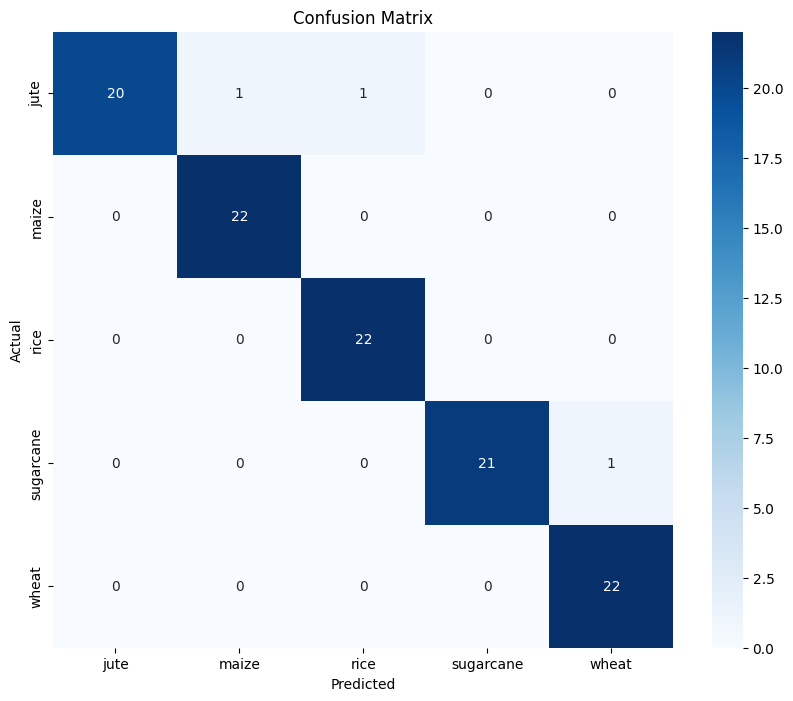

In [169]:
# Extract features
X_train_features = extract_features(X_train)
X_test_features = extract_features(X_test)

# Flatten labels
y_train_flat = y_train.argmax(axis=1)
y_test_flat = y_test.argmax(axis=1)

# Train Random Forest
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train_features, y_train_flat)

# Evaluate model
y_pred = rf_model.predict(X_test_features)
accuracy = accuracy_score(y_test_flat, y_pred)
print("Random Forest Accuracy:", accuracy)

# Confusion Matrix
cm = confusion_matrix(y_test_flat, y_pred)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=oh.categories_[0], yticklabels=oh.categories_[0])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Save the model
with open('/kaggle/working/best_random_forest_model_vgg.pkl', 'wb') as file:
    pickle.dump(rf_model, file)

# Function to predict crop images
def predict_crop_image(path):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    model = Model(inputs=base_model.input, outputs=base_model.output)

    img = cv2.imread(path)
    img = cv2.resize(img, (224, 224))
    img = img.astype(np.float32) / 255.0
    img = img.reshape(1, 224, 224, 3)

    # Extract features using VGG16
    features = model.predict(img)
    img_flat = features.flatten().reshape(1, -1)  # Reshape for prediction

    # Load the model
    with open('/kaggle/working/best_random_forest_model_vgg.pkl', 'rb') as file:
        best_model = pickle.load(file)

    pred_class = best_model.predict(img_flat)[0]  # Get the predicted class

    # Class labels
    class_labels = ["jute", "maize", "rice", "sugarcane", "wheat"]

    # Display the prediction without probability
    plt.title(f"Prediction: {class_labels[pred_class]}")
    plt.imshow(cv2.cvtColor(img[0], cv2.COLOR_BGR2RGB))  # Display the actual image
    plt.axis('off')
    plt.show()

Image prediction

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 831ms/step


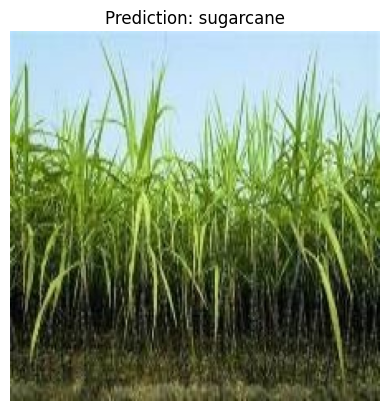

In [170]:
predict_crop_image('/kaggle/input/kag2/sugarcane/sugarcane0004ahf.jpeg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


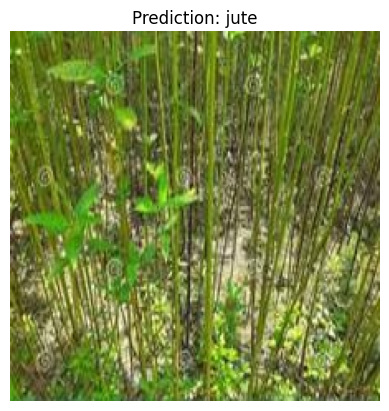

In [171]:
predict_crop_image('/kaggle/input/kag2/jute/jute003a.jpeg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 698ms/step


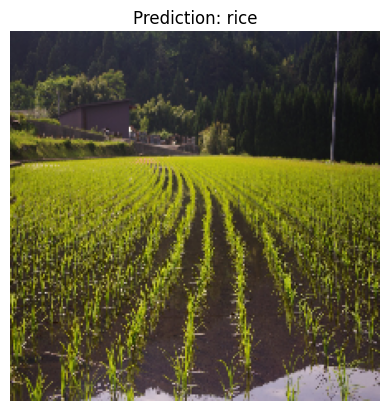

In [172]:
predict_crop_image('/kaggle/input/test_crop_image/rice-828540_1280.jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step


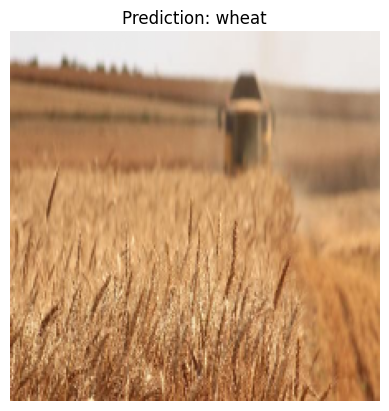

In [173]:
predict_crop_image('/kaggle/input/test_crop_image/wheatcrops.jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 701ms/step


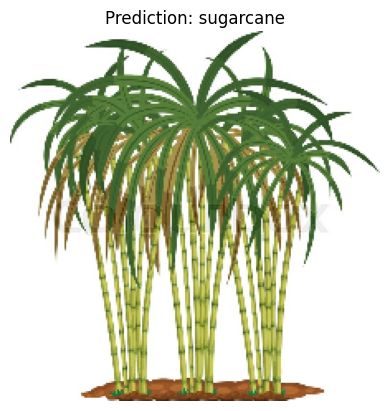

In [174]:
predict_crop_image('/kaggle/input/test_crop_image/sugarcaneplant.jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step


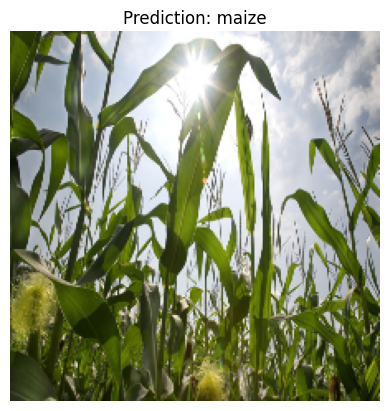

In [175]:
predict_crop_image('/kaggle/input/test_crop_image/maize00corn-fields.jpg')

Deploying our app with Streamlit

In [176]:
#Installing 'localtunnel' Module to create SSH Tunnels For connecting to Local Web Server
!npm install -g localtunnel


changed 22 packages, and audited 23 packages in 1s

3 packages are looking for funding
  run `npm fund` for details

1 moderate severity vulnerability

To address all issues (including breaking changes), run:
  npm audit fix --force

Run `npm audit` for details.


In [177]:
!pip install streamlit

In [178]:
%%writefile agriculture_ml_app.py
import streamlit as st
import numpy as np
import pandas as pd
import pickle
from PIL import Image
import cv2
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model

# Load the saved Random Forest model
with open('/kaggle/working/best_random_forest_model_vgg.pkl', 'rb') as file:
    rf_model = pickle.load(file)

# Function to preprocess and predict the crop image
def predict_crop_image(path):
    # Load the VGG16 base model for feature extraction
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    model = Model(inputs=base_model.input, outputs=base_model.output)

    # Read and preprocess the image
    img = cv2.imread(path)
    img = cv2.resize(img, (224, 224))
    img = img.astype(np.float32) / 255.0
    img = img.reshape(1, 224, 224, 3)

    # Extract features using VGG16
    features = model.predict(img)
    img_flat = features.flatten().reshape(1, -1)  # Reshape for prediction

    # Predict the class
    pred_class = rf_model.predict(img_flat)

    # Class labels
    class_labels = ["jute", "maize", "rice", "sugarcane", "wheat"]
    return class_labels[pred_class[0]]

# Streamlit UI
st.title("Agricultural Crop Classification App")
st.write("Upload an image of a crop and the model will classify it.")

# File uploader
uploaded_file = st.file_uploader("Choose a crop image...", type=["jpg", "png", "jpeg"])

if uploaded_file is not None:
    # Display the uploaded image
    image = Image.open(uploaded_file)
    st.image(image, caption='Uploaded Image', use_column_width=True)

    # Save the uploaded file to a temporary location
    with open("temp_image.jpg", "wb") as f:
        f.write(uploaded_file.getbuffer())

    # Predict the class
    if st.button("Classify"):
        prediction = predict_crop_image("temp_image.jpg")
        st.write(f"Prediction: {prediction}")


Overwriting agriculture_ml_app.py


In [ ]:
!streamlit run agriculture_ml_app.py & npx localtunnel --port 8501




  You can now view your Streamlit app in your browser.

  Local URL: http://localhost:8501
  Network URL: http://172.28.0.12:8501
  External URL: http://34.148.200.28:8501

your url is: https://long-windows-suffer.loca.lt
2024-10-18 00:07:09.724829: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-18 00:07:09.770964: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-18 00:07:09.785599: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-18 00:07:12.368878: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
1/1 ━━━━━━━━━━━━